# **Athlete360 - Predictive Analytics for Performance, Fatique, Injury and Training Recommendations**

---

##  **CRISP-DM Phase 1: Business Understanding**

###  **Business Idea**

Modern sports organizations collect massive amounts of performance and training data, yet most insights remain siloed, physical performance metrics are rarely analyzed alongside mental readiness indicators.
**Athlete360** aims to bridge that gap by developing a data-driven system that integrates player performance statistics, workload metrics,to provide a holistic view of athlete readiness.

This system will help **coaches, analysts, and athletes** make more informed decisions about:

* Player rotation and rest,
* Training focus and recovery strategies,
* Injury prevention,

---

### **Vision**

> **To create an intelligent analytics platform that merges physical performance, fatigue and injury, enabling smarter, safer, and more personalized coaching decisions.**

Athlete360 envisions an ecosystem where **AI supports human intuition** , empowering athletes to perform better while reducing risk of overtraining or injury.

---

### **Project Objectives**

|     | Objective                                                  | Description                                                                                                                                  |
| ----- | ---------------------------------------------------------- | -------------------------------------------------------------------------------------------------------------------------------------------- |
| **1** | **Predict Game Performance**                               | Build a machine learning model that forecasts next-game player performance based on past statistics, opponent strength, and fatigue metrics. |
| **2** | **Recommend Training Focus**                               | Develop a clustering-based recommender that suggests personalized training adjustments based on performance trends.                          |
| **3** | **Estimate Injury Risk**                                   | Use workload and fatigue indicators to flag players at elevated injury risk.                                                                 |
| **4** | **Unify Metrics into an Athlete Intelligence Index (AII)** | Combine model outputs into a single composite score to represent overall athlete readiness.                                                  |

---

### **Business Success Metrics**

| Category                 | Metric                                          | Success Criteria                                                   |
| ------------------------ | ----------------------------------------------- | ------------------------------------------------------------------ |
| **Predictive Accuracy**  | Model R² or RMSE for performance prediction     | R² ≥ 0.70 or RMSE ≤ 3 points                                       |
| **Actionability**        | Interpretability and clarity of recommendations | Recommendations easily understood by non-technical users (coaches) |
| **Usability**            | Streamlit dashboard prototype                   | Interactive dashboard showing player insights and AII              |
| **Scalability (Future)** | System design extensibility                     | Ability to scale with more seasons or other sports data            |

---

### **Key Business Questions**

1. Can we accurately predict an athlete’s next-game performance based on past trends and workload?
2. What statistical patterns indicate a player is entering a fatigue or risk zone?
3. How can training recommendations be generated automatically from player performance clusters?
4. Can we combine these insights into a unified **Athlete Intelligence Index (AII)** that summarizes readiness?

---

### **Scope of This Proof of Concept**

This PoC will focus on NBA data (2018–2021) due to API access limitations. It will:

* Validate the **feasibility** of modeling the three core components (performance, training, injury).
* Demonstrate **data-driven insights** through a lightweight Streamlit dashboard.
* Lay the foundation for future extensions into real-time systems and cross-sport applications.

---


##  **CRISP-DM Phase 2: Data Understanding**

###  **Overview**

In this phase, we focus on getting familiar with the dataset, understanding what each column represents, checking data quality, and identifying patterns or potential issues before we move on to cleaning and modeling.

Our dataset was collected using the **NBA API**, covering **player-level game data** from **2018 to 2021**. Each row in the dataset represents a **single player’s performance in one game**, with additional contextual and derived features that describe factors like fatigue, momentum, and opponent strength.

---

###  **Column Descriptions**

Below is a breakdown of all the main columns in the dataset and what each one represents.

| **Category**                             | **Column Name**              | **Description / Meaning**                                                               |
| ---------------------------------------- | ---------------------------- | --------------------------------------------------------------------------------------- |
| **Game Information**                     | `GAME_DATE`                  | The date when the game took place.                                                      |
|                                          | `SEASON_ID`                  | The NBA season identifier (e.g., 2018–19 = 22018).                                      |
|                                          | `Game_ID`                    | Unique ID for each game.                                                                |
|                                          | `MATCHUP`                    | Shows which teams played and who was home/away (e.g., “LAL vs BOS”).                    |
|                                          | `WL`                         | Win or loss result for the player’s team in that game (“W” or “L”).                     |
| **Player Details**                       | `PLAYER_ID`                  | Unique ID for the player.                                                               |
|                                          | `player_name`                | Player’s full name.                                                                     |
|                                          | `TEAM_ABBREVIATION`          | Abbreviation of the player’s team (e.g., “LAL” for Lakers).                             |
|                                          | `OPPONENT_ABBREVIATION`      | Abbreviation of the opposing team.                                                      |
| **Performance Statistics**               | `PTS`                        | Total points scored by the player in the game.                                          |
|                                          | `AST`                        | Number of assists made.                                                                 |
|                                          | `REB`                        | Total rebounds (offensive + defensive).                                                 |
|                                          | `FGM`                        | Field goals made.                                                                       |
|                                          | `FGA`                        | Field goals attempted.                                                                  |
|                                          | `FG_PCT`                     | Field goal percentage (`FGM` / `FGA`).                                                  |
|                                          | `STL`                        | Steals recorded by the player.                                                          |
|                                          | `BLK`                        | Blocks made by the player.                                                              |
|                                          | `TOV`                        | Turnovers committed by the player.                                                      |
|                                          | `PF`                         | Personal fouls committed.                                                               |
|                                          | `PLUS_MINUS`                 | Point differential when the player was on the court.                                    |
| **Fatigue & Schedule Features**          | `days_since_last`            | Days since the player’s previous game.                                                  |
|                                          | `back_to_back`               | Binary flag (1/0) indicating if the game was played on consecutive days.                |
|                                          | `games_last_7`               | Number of games played by the player in the last 7 days.                                |
|                                          | `games_last_30`              | Number of games played in the last 30 days.                                             |
|                                          | `fatigue_index`              | A composite feature estimating the player’s fatigue based on schedule and minutes.      |
|                                          | `gap_days`                   | The gap (in days) between this and the next scheduled game.                             |
| **Rolling Performance (Trend Features)** | `roll_PTS_mean`              | Average points scored over the last N games (rolling window).                           |
|                                          | `roll_PTS_std`               | Standard deviation of points over the last N games — measures consistency.              |
|                                          | `roll_AST_mean`              | Average assists over recent games.                                                      |
|                                          | `roll_FG_PCT_mean`           | Average shooting percentage in recent games.                                            |
|                                          | `roll_TOV_std`               | Turnover variability — how erratic the player’s ball handling has been.                 |
| **Opponent Context**                     | `OPP_DEF_RATING`             | Opponent team’s defensive rating (points allowed per 100 possessions).                  |
|                                          | `OPP_PACE`                   | Opponent’s average pace (possessions per game).                                         |
|                                          | `OPP_SEASON_AVG_PTS_ALLOWED` | Average points allowed by the opponent over the season.                                 |
|                                          | `OPP_FG_PCT_ALLOWED`         | Average field goal percentage allowed by the opponent.                                  |
| **Derived / Custom Features**            | `hot_streak`                 | Binary flag indicating if the player’s recent performance is trending above average.    |
|                                          | `hot_streak_count`           | Number of consecutive “hot” games.                                                      |
|                                          | `last_vs_roll_pts_diff`      | Difference between last game points and rolling average — measures improvement or drop. |

---

###  **Initial Insights**

1. **Coverage:**
   Dataset includes thousands of player-game entries between 2018 and 2021 — sufficient for performance and fatigue modeling.

2. **Completeness:**

   * Core box score data (e.g., points, assists, rebounds) is mostly complete.
   * Rolling features contain missing values for early-season games, since rolling stats require prior games to calculate.

3. **Feature Variety:**
   Dataset includes both raw stats and engineered features, supporting multiple modeling tasks (prediction, clustering, or classification).

---

### **Data Quality Checks**

| **Issue**        | **Explanation**                                                     | **Next Step / Solution**                                      |
| ---------------- | ------------------------------------------------------------------- | ------------------------------------------------------------- |
| Missing values   | Common in rolling and fatigue-related columns early in each season. | Impute using player averages or drop first few games.         |
| Player imbalance | Some players have fewer games recorded (e.g., rookies or injuries). | Focus on players with consistent participation (≥ 100 games). |
| Data scaling     | Metrics have different scales (e.g., PTS vs FG_PCT).                | Standardize before modeling or clustering.                    |
| Time dependency  | Stats are sequential — order matters.                               | Split data by season or use time-aware validation.            |

---

### **Planned Exploratory Analysis**

Our team will conduct the following analyses before modeling:

* Distribution of **points**, **minutes**, and **fatigue index**
* Correlations between **fatigue features** and **performance**
* Rolling trend visualizations (e.g., moving averages)
* Opponent defensive rating vs player output
* Player clustering based on rolling stats and fatigue metrics

---

### **Goal of This Phase**

By the end of the **Data Understanding** phase, our team will:

* Understand what each variable represents
* Verify data quality and consistency
* Identify key predictors for modeling
* Prepare for the **Data Preparation** phase (feature cleaning, scaling, encoding, and train/test splitting)

---

In [1]:
# Importing core libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import plotly.express as px

import warnings
warnings.filterwarnings('ignore')

# Importing sklearn libraries
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LinearRegression, PoissonRegressor, Ridge
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier, GradientBoostingRegressor, StackingRegressor
from sklearn.cluster import KMeans
from sklearn.metrics import mean_absolute_error, r2_score, accuracy_score, silhouette_score, confusion_matrix,\
      classification_report, roc_auc_score, roc_curve
from sklearn.preprocessing import LabelEncoder
from scipy.stats import randint, uniform
from scipy import stats

# Other libraries
!pip install optuna
import optuna
import lightgbm as lgb
from xgboost import XGBRegressor




In [2]:
# Loading the dataset
df = pd.read_csv("/Users/arasirwa/personal-projects/scaling-octo-garbanzo/data/player_game_logs_2018_24_merged.csv")
df

,GAME_DATE,SEASON_ID,Player_ID,Game_ID,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,...,fatigue_index,gap_days,OPP_SEASON_AVG_BLK,OPP_SEASON_AVG_STL,OPP_DEF_RATING,OPP_PACE,OPP_SEASON_AVG_PTS_ALLOWED,OPP_FG_PCT_ALLOWED,OPP_FG3_PCT_ALLOWED,OPP_PTS_PAINT_ALLOWED
0,2020-12-22,2020_21,2544,22000002,LAL vs. LAC,L,28,7,17,0.412,...,0.777778,999.0,295,509,110.6,97.63,7764.0,0.464,0.356,3400.0
1,2020-12-25,2020_21,2544,22000008,LAL vs. DAL,W,31,8,18,0.444,...,0.961111,3.0,311,450,112.3,97.94,7933.0,0.460,0.365,3256.0
2,2020-12-27,2020_21,2544,22000040,LAL vs. MIN,W,26,6,13,0.462,...,0.922222,2.0,398,632,114.5,101.96,8473.0,0.482,0.392,3584.0
3,2020-12-28,2020_21,2544,22000045,LAL vs. POR,L,36,11,20,0.550,...,1.600000,1.0,363,496,115.3,98.97,8231.0,0.473,0.372,3406.0
4,2020-12-30,2020_21,2544,22000060,LAL @ SAS,W,35,11,23,0.478,...,1.372222,2.0,366,505,112.0,99.45,8123.0,0.472,0.377,3608.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
459522,2020-08-13,2019_20,1629752,21901314,UTA vs. SAS,W,22,3,4,0.750,...,1.011111,6.0,419,576,111.6,101.11,8854.0,0.464,0.368,3704.0
459523,2020-01-20,2019_20,1629760,21900643,CLE vs. NYK,L,3,1,2,0.500,...,0.083333,999.0,354,535,111.7,99.54,7862.0,0.457,0.374,3080.0
459524,2020-01-28,2019_20,1629760,21900700,CLE vs. NOP,L,2,0,0,0.000,...,0.155556,8.0,392,594,110.7,103.91,8930.0,0.461,0.355,3992.0
459525,2020-03-02,2019_20,1629760,21900902,CLE vs. UTA,L,1,0,0,0.000,...,0.127778,34.0,331,500,108.2,99.34,8495.0,0.454,0.350,3716.0


In [3]:
# Checking the first five rows
df.head()


,GAME_DATE,SEASON_ID,Player_ID,Game_ID,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,...,fatigue_index,gap_days,OPP_SEASON_AVG_BLK,OPP_SEASON_AVG_STL,OPP_DEF_RATING,OPP_PACE,OPP_SEASON_AVG_PTS_ALLOWED,OPP_FG_PCT_ALLOWED,OPP_FG3_PCT_ALLOWED,OPP_PTS_PAINT_ALLOWED
0,2020-12-22,2020_21,2544,22000002,LAL vs. LAC,L,28,7,17,0.412,...,0.777778,999.0,295,509,110.6,97.63,7764.0,0.464,0.356,3400.0
1,2020-12-25,2020_21,2544,22000008,LAL vs. DAL,W,31,8,18,0.444,...,0.961111,3.0,311,450,112.3,97.94,7933.0,0.460,0.365,3256.0
2,2020-12-27,2020_21,2544,22000040,LAL vs. MIN,W,26,6,13,0.462,...,0.922222,2.0,398,632,114.5,101.96,8473.0,0.482,0.392,3584.0
3,2020-12-28,2020_21,2544,22000045,LAL vs. POR,L,36,11,20,0.550,...,1.600000,1.0,363,496,115.3,98.97,8231.0,0.473,0.372,3406.0
4,2020-12-30,2020_21,2544,22000060,LAL @ SAS,W,35,11,23,0.478,...,1.372222,2.0,366,505,112.0,99.45,8123.0,0.472,0.377,3608.0


In [4]:
# Checking the last five rows
df.tail()

,GAME_DATE,SEASON_ID,Player_ID,Game_ID,MATCHUP,WL,MIN,FGM,FGA,FG_PCT,...,fatigue_index,gap_days,OPP_SEASON_AVG_BLK,OPP_SEASON_AVG_STL,OPP_DEF_RATING,OPP_PACE,OPP_SEASON_AVG_PTS_ALLOWED,OPP_FG_PCT_ALLOWED,OPP_FG3_PCT_ALLOWED,OPP_PTS_PAINT_ALLOWED
459522,2020-08-13,2019_20,1629752,21901314,UTA vs. SAS,W,22,3,4,0.75,...,1.011111,6.0,419,576,111.6,101.11,8854.0,0.464,0.368,3704.0
459523,2020-01-20,2019_20,1629760,21900643,CLE vs. NYK,L,3,1,2,0.50,...,0.083333,999.0,354,535,111.7,99.54,7862.0,0.457,0.374,3080.0
459524,2020-01-28,2019_20,1629760,21900700,CLE vs. NOP,L,2,0,0,0.00,...,0.155556,8.0,392,594,110.7,103.91,8930.0,0.461,0.355,3992.0
459525,2020-03-02,2019_20,1629760,21900902,CLE vs. UTA,L,1,0,0,0.00,...,0.127778,34.0,331,500,108.2,99.34,8495.0,0.454,0.350,3716.0
459526,2020-03-10,2019_20,1629760,21900962,CLE @ CHI,L,13,0,2,0.00,...,0.461111,8.0,287,695,108.4,100.56,7569.0,0.473,0.350,3412.0


Observations: The data is uniform from top to bottom

In [5]:
# Checking the shape
print(f"The dataset has {df.shape[0]} records and {df.shape[1]} variables")

The dataset has 459527 records and 66 variables


In [6]:
# Checking the data types
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 459527 entries, 0 to 459526
Data columns (total 66 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   GAME_DATE                   459527 non-null  object 
 1   SEASON_ID                   459527 non-null  object 
 2   Player_ID                   459527 non-null  int64  
 3   Game_ID                     459527 non-null  int64  
 4   MATCHUP                     459527 non-null  object 
 5   WL                          459527 non-null  object 
 6   MIN                         459527 non-null  int64  
 7   FGM                         459527 non-null  int64  
 8   FGA                         459527 non-null  int64  
 9   FG_PCT                      459527 non-null  float64
 10  FG3M                        459527 non-null  int64  
 11  FG3A                        459527 non-null  int64  
 12  FG3_PCT                     459527 non-null  float64
 13  FTM           

Observation: The dataset has 60 numerical columns and 6 categorical columns

In [7]:
# Checking statistical summary
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Player_ID,459527.0,8.271796e+05,717840.654042,1.713000e+03,2.023970e+05,2.039320e+05,1.627885e+06,1.630466e+06
Game_ID,459527.0,2.181551e+07,47645.724306,2.180000e+07,2.180034e+07,2.180068e+07,2.180102e+07,2.200108e+07
MIN,459527.0,2.277545e+01,10.278722,0.000000e+00,1.600000e+01,2.400000e+01,3.100000e+01,5.600000e+01
FGM,459527.0,3.873030e+00,3.131766,0.000000e+00,1.000000e+00,3.000000e+00,6.000000e+00,2.100000e+01
FGA,459527.0,8.405432e+00,5.809630,0.000000e+00,4.000000e+00,7.000000e+00,1.200000e+01,4.100000e+01
FG_PCT,459527.0,4.299337e-01,0.244047,0.000000e+00,2.860000e-01,4.440000e-01,5.710000e-01,1.000000e+00
FG3M,459527.0,1.079808e+00,1.396463,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+00,1.400000e+01
FG3A,459527.0,3.036727e+00,2.891074,0.000000e+00,1.000000e+00,2.000000e+00,5.000000e+00,2.400000e+01
FG3_PCT,459527.0,2.521525e-01,0.293207,0.000000e+00,0.000000e+00,2.000000e-01,5.000000e-01,1.000000e+00
FTM,459527.0,1.670335e+00,2.290047,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+00,2.600000e+01


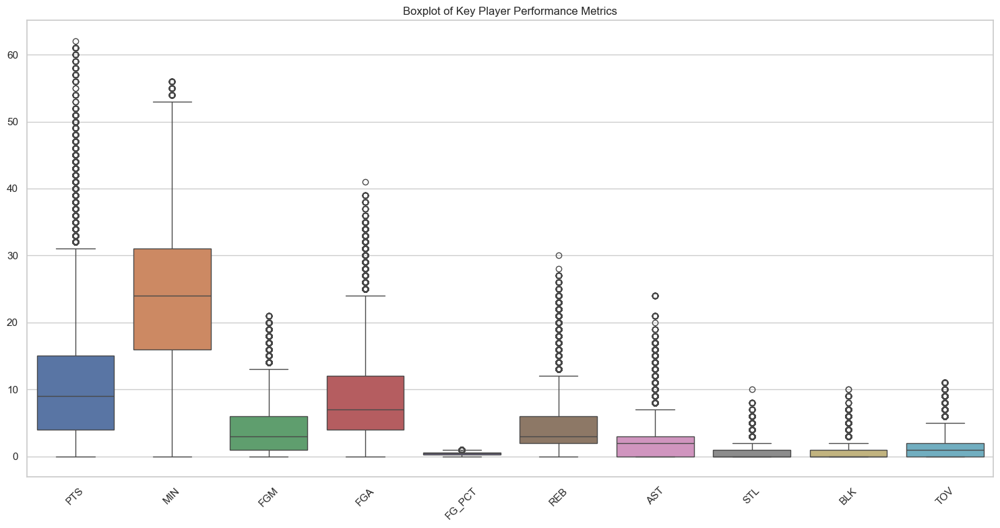

In [8]:
# Checking for outliers
stats_columns = ['PTS', 'MIN', 'FGM', 'FGA', 'FG_PCT', 'REB', 'AST', 'STL', 'BLK', 'TOV']

# Set plot style
sns.set(style="whitegrid")

# Create a boxplot for each metric
plt.figure(figsize=(15, 8))
sns.boxplot(data=df[stats_columns])
plt.title("Boxplot of Key Player Performance Metrics")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Observations:

- This is a rich player-game level dataset capturing individual performance, team context, and opponent characteristics. 
- There is high variability in scoring, shooting, and rebounding, with most players performing in a moderate range and a few extreme outliers driving the maximum values. We will keep the outliers since they are genuine.
- Rolling and contextual metrics suggest it’s well-prepared for predictive modeling of performance trends.

##  **CRISP-DM Phase 3: Data Preparation**
### **Data Cleaning**

In this phase, we prepared the NBA dataset for analysis and modeling by cleaning, standardizing, and organizing the data. Key steps included renaming columns to meaningful names for readability, handling missing values in rolling statistics and verifying data types. This ensures that the dataset is structured, consistent, and ready for exploratory data analysis and subsequent modeling.

In [9]:
# Creating a copy to retain the original dataset
data = df.copy(deep = True)

In [10]:
# Checking the column names
data.columns

Index(['GAME_DATE', 'SEASON_ID', 'Player_ID', 'Game_ID', 'MATCHUP', 'WL',
       'MIN', 'FGM', 'FGA', 'FG_PCT', 'FG3M', 'FG3A', 'FG3_PCT', 'FTM', 'FTA',
       'FT_PCT', 'OREB', 'DREB', 'REB', 'AST', 'STL', 'BLK', 'TOV', 'PF',
       'PTS', 'PLUS_MINUS', 'VIDEO_AVAILABLE', 'PLAYER_ID', 'player_name',
       'TEAM_ABBREVIATION', 'OPPONENT_ABBREVIATION', 'TEAM_ID', 'OPPONENT_ID',
       'days_since_last', 'back_to_back', 'games_last_7', 'games_last_30',
       'roll_PTS_mean', 'roll_PTS_std', 'roll_AST_mean', 'roll_AST_std',
       'roll_REB_mean', 'roll_REB_std', 'roll_FG_PCT_mean', 'roll_FG_PCT_std',
       'roll_FG3_PCT_mean', 'roll_FG3_PCT_std', 'roll_FTA_mean',
       'roll_FTA_std', 'roll_TOV_mean', 'roll_TOV_std', 'roll_MIN_mean',
       'roll_MIN_std', 'last_vs_roll_pts_diff', 'hot_streak',
       'hot_streak_count', 'fatigue_index', 'gap_days', 'OPP_SEASON_AVG_BLK',
       'OPP_SEASON_AVG_STL', 'OPP_DEF_RATING', 'OPP_PACE',
       'OPP_SEASON_AVG_PTS_ALLOWED', 'OPP_FG_PCT_ALLOWE

In [11]:
# Renaming the column names for ease of understanding
# Dictionary for renaming columns
rename_dict = {
    'SEASON_ID': 'Season',
    'WL': 'Win_Loss',
    'MIN': 'Minutes_Played',
    'TOV' : 'Turnovers',
    'FGM': 'Field_Goals_Made',
    'FGA': 'Field_Goals_Attempted',
    'FG_PCT': 'Field_Goal_Pct',
    'FG3M': 'ThreePoints_Made',
    'FG3A': 'ThreePoints_Attempted',
    'FG3_PCT': 'ThreePoints_Pct',
    'FTM': 'FreeThrows_Made',
    'FTA': 'FreeThrows_Attempted',
    'FT_PCT': 'FreeThrow_Pct',
    'OREB': 'Offensive_Rebounds',
    'DREB': 'Defensive_Rebounds',
    'REB': 'Total_Rebounds',
    'AST': 'Assists',
    'STL': 'Steals',
    'BLK': 'Blocks',
    'PF': 'Personal_Fouls',
    'PTS': 'Points',
    'days_since_last': 'Days_Since_Last_Game',
    'back_to_back': 'Back_To_Back_Games',
    'roll_PTS_mean': 'Rolling_Points_Mean',
    'roll_PTS_std': 'Rolling_Points_Std',
    'roll_AST_mean': 'Rolling_Assists_Mean',
    'roll_AST_std': 'Rolling_Assists_Std',
    'roll_REB_mean': 'Rolling_Rebounds_Mean',
    'roll_REB_std': 'Rolling_Rebounds_Std',
    'roll_FG_PCT_mean': 'Rolling_Field_Goal_Pct_Mean',
    'roll_FG_PCT_std': 'Rolling_Field_Goal_Pct_Std',
    'roll_FG3_PCT_mean': 'Rolling_3Pt_Pct_Mean',
    'roll_FG3_PCT_std': 'Rolling_3Pt_Pct_Std',
    'roll_FTA_mean': 'Rolling_Free_Throws_Mean',
    'roll_FTA_std': 'Rolling_Free_Throws_Std',
    'roll_TOV_mean': 'Rolling_Turnovers_Mean',
    'roll_TOV_std': 'Rolling_Turnovers_Std',
    'roll_MIN_mean': 'Rolling_Minutes_Mean',
    'roll_MIN_std': 'Rolling_Minutes_Std',
    'last_vs_roll_pts_diff': 'Last_vs_Rolling_Points_Diff',
    'hot_streak': 'Hot_Streak_Flag',
    'OPP_SEASON_AVG_BLK': 'Opponent_Avg_Blocks',
    'OPP_SEASON_AVG_STL': 'Opponent_Avg_Steals',
    'OPP_DEF_RATING': 'Opponent_Def_Rating',
    'OPP_PACE': 'Opponent_Pace',
    'OPP_SEASON_AVG_PTS_ALLOWED': 'Opponent_Avg_Points_Allowed',
    'OPP_FG_PCT_ALLOWED': 'Opponent_Field_Goals_Pct_Allowed',
    'OPP_FG3_PCT_ALLOWED': 'Opponent_3Pt_Pct_Allowed',
    'OPP_PTS_PAINT_ALLOWED': 'Opponent_Points_Paint_Allowed'
}

# Apply renaming
data.rename(columns =rename_dict, inplace=True)

#checking if changes have occured
data.columns


Index(['GAME_DATE', 'Season', 'Player_ID', 'Game_ID', 'MATCHUP', 'Win_Loss',
       'Minutes_Played', 'Field_Goals_Made', 'Field_Goals_Attempted',
       'Field_Goal_Pct', 'ThreePoints_Made', 'ThreePoints_Attempted',
       'ThreePoints_Pct', 'FreeThrows_Made', 'FreeThrows_Attempted',
       'FreeThrow_Pct', 'Offensive_Rebounds', 'Defensive_Rebounds',
       'Total_Rebounds', 'Assists', 'Steals', 'Blocks', 'Turnovers',
       'Personal_Fouls', 'Points', 'PLUS_MINUS', 'VIDEO_AVAILABLE',
       'PLAYER_ID', 'player_name', 'TEAM_ABBREVIATION',
       'OPPONENT_ABBREVIATION', 'TEAM_ID', 'OPPONENT_ID',
       'Days_Since_Last_Game', 'Back_To_Back_Games', 'games_last_7',
       'games_last_30', 'Rolling_Points_Mean', 'Rolling_Points_Std',
       'Rolling_Assists_Mean', 'Rolling_Assists_Std', 'Rolling_Rebounds_Mean',
       'Rolling_Rebounds_Std', 'Rolling_Field_Goal_Pct_Mean',
       'Rolling_Field_Goal_Pct_Std', 'Rolling_3Pt_Pct_Mean',
       'Rolling_3Pt_Pct_Std', 'Rolling_Free_Throws_Mean

In [12]:
data.shape

(459527, 66)

In [13]:
# Standardizing the column names
data.columns = data.columns.str.lower()

# Convert game_date to datetime
data['game_date'] = pd.to_datetime(data['game_date'])

# Checking if changes have occured
data.columns

Index(['game_date', 'season', 'player_id', 'game_id', 'matchup', 'win_loss',
       'minutes_played', 'field_goals_made', 'field_goals_attempted',
       'field_goal_pct', 'threepoints_made', 'threepoints_attempted',
       'threepoints_pct', 'freethrows_made', 'freethrows_attempted',
       'freethrow_pct', 'offensive_rebounds', 'defensive_rebounds',
       'total_rebounds', 'assists', 'steals', 'blocks', 'turnovers',
       'personal_fouls', 'points', 'plus_minus', 'video_available',
       'player_id', 'player_name', 'team_abbreviation',
       'opponent_abbreviation', 'team_id', 'opponent_id',
       'days_since_last_game', 'back_to_back_games', 'games_last_7',
       'games_last_30', 'rolling_points_mean', 'rolling_points_std',
       'rolling_assists_mean', 'rolling_assists_std', 'rolling_rebounds_mean',
       'rolling_rebounds_std', 'rolling_field_goal_pct_mean',
       'rolling_field_goal_pct_std', 'rolling_3pt_pct_mean',
       'rolling_3pt_pct_std', 'rolling_free_throws_mean

In [14]:
data.columns[data.columns.duplicated()]
data = data.loc[:, ~data.columns.duplicated()].copy()
data.columns[data.columns.duplicated()]

Index([], dtype='object')

In [15]:
# Checking for missing values
data.isna().sum().any()
# Dropping  the missing values
data.dropna(inplace = True)

#Checking if changes have occured
data.isna().sum().any()

False

In [16]:
# Checking for duplicates
data.duplicated().sum()

0

Observations:

The dataset is fairly clean,and has no duplicates.

In [17]:
# Save the clean data
data.to_csv("clean_data.csv", index=False)

### **Exploratory Data Analysis**
#### **Univariate Analysis**
Understanding distributions of single variables of points, minutes, fatigue_index,assists, total_rebounds, field_goal_pct,
threepoints_pct, freethrow_pct and turnovers.

In [18]:
data1= pd.read_csv("clean_data.csv")
data1.columns

Index(['game_date', 'season', 'player_id', 'game_id', 'matchup', 'win_loss',
       'minutes_played', 'field_goals_made', 'field_goals_attempted',
       'field_goal_pct', 'threepoints_made', 'threepoints_attempted',
       'threepoints_pct', 'freethrows_made', 'freethrows_attempted',
       'freethrow_pct', 'offensive_rebounds', 'defensive_rebounds',
       'total_rebounds', 'assists', 'steals', 'blocks', 'turnovers',
       'personal_fouls', 'points', 'plus_minus', 'video_available',
       'player_name', 'team_abbreviation', 'opponent_abbreviation', 'team_id',
       'opponent_id', 'days_since_last_game', 'back_to_back_games',
       'games_last_7', 'games_last_30', 'rolling_points_mean',
       'rolling_points_std', 'rolling_assists_mean', 'rolling_assists_std',
       'rolling_rebounds_mean', 'rolling_rebounds_std',
       'rolling_field_goal_pct_mean', 'rolling_field_goal_pct_std',
       'rolling_3pt_pct_mean', 'rolling_3pt_pct_std',
       'rolling_free_throws_mean', 'rolling_f

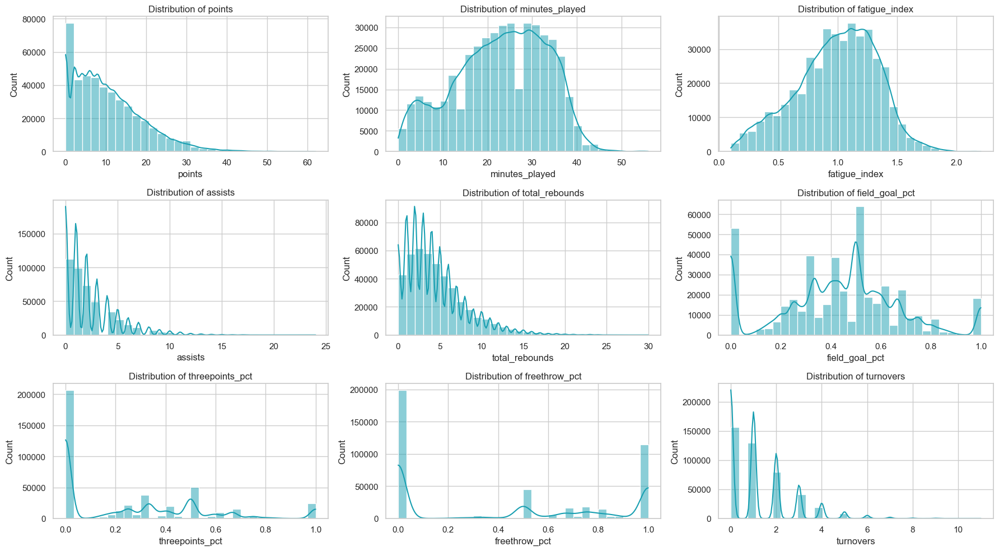

In [19]:
# Numeric columns
numeric_cols = [
    'points', 'minutes_played', 'fatigue_index', 
    'assists', 'total_rebounds', 'field_goal_pct',
    'threepoints_pct', 'freethrow_pct', 'turnovers'
]

# Plot distributions of numerical columns
plt.figure(figsize=(18, 10))
for i, col in enumerate(numeric_cols, 1):
    plt.subplot(3, 3, i)
    sns.histplot(data1[col], kde=True, bins=30, color='#189fb1')
    plt.title(f'Distribution of {col}')
plt.tight_layout()
plt.show()

Observations:

* The points distribution is right-skewed  most players score below 15 points per game, with a few high scorers creating a long tail.

* Minutes played show a moderate spread; most players average between 16-35 minutes, suggesting a mix of starters and bench players.

* The fatigue_index follows an approximately normal distribution, indicating that most players experience moderate fatigue levels, with fewer cases of extreme rest or overwork.

* Assists and total rebounds distributions are also right-skewed where a few players consistently dominate these categories.

* Shooting percentages (field_goal_pct, threepoints_pct and freethrow_pct) display uneven or multi-peaked patterns, showing that shooting efficiency varies widely suggesting some players are highly accurate, while others struggle.

* Turnovers are concentrated at lower values, showing most players commit between 0–4 turnovers per game.

#### **Bivariate Analysis**
Understanding the correlation between fatigue features and performance

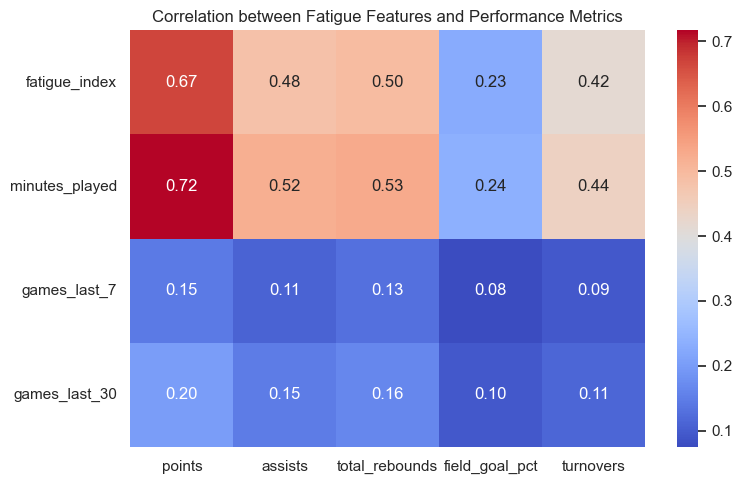

In [20]:
# Define relevant columns
fatigue_features = ['fatigue_index', 'minutes_played', 'games_last_7', 'games_last_30']
performance_features = ['points', 'assists', 'total_rebounds', 'field_goal_pct', 'turnovers']

# Compute correlations between fatigue and performance metrics
corr_data = data1[fatigue_features + performance_features].corr()
fatigue_corr = corr_data.loc[fatigue_features, performance_features]

# Plot heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(fatigue_corr, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation between Fatigue Features and Performance Metrics')
plt.tight_layout()
plt.show()

Observations:

* Fatigue_index shows a positive correlation with points (0.67), assists (0.48), total_rebounds (0.50), and field_goal_pct (0.23), implying that higher workload players tend to accumulate more counting stats and maintain decent shooting efficiency despite fatigue.

* Minutes_played and fatigue_index are strongly positively correlated, confirming that heavy playing time contributes to higher fatigue levels.

* Turnovers display a moderate positive correlation (0.42) with fatigue, suggesting that players with heavier workloads may make slightly more ball-handling mistakes.

* Games_last_7 and games_last_30 have weaker correlations with performance metrics, indicating that short-term game density affects performance less consistently than cumulative fatigue or playing time.

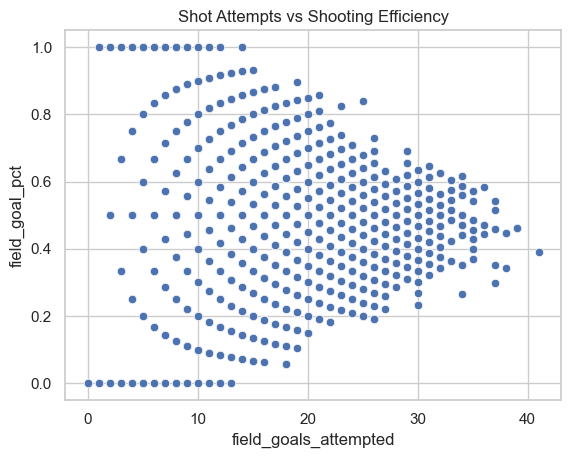

In [21]:
# Scatter plot of field goal attempts vs field goal percentage.
sns.scatterplot(x='field_goals_attempted', y='field_goal_pct', data=data)
plt.title("Shot Attempts vs Shooting Efficiency")
plt.show()

Observations:

* There is a visible relationship showing that players who attempt more shots tend to have a wider spread in shooting efficiency, but not necessarily higher accuracy.

* Players with few shot attempts show extreme efficiency values (either 0% or 100%), likely due to small sample size.

* As field goal attempts increase, the distribution of shooting percentages narrows, clustering around the 0.4–0.6 range.

* High attempt players show more stable shooting efficiency implying that efficiency stabilizes with volume.

* No strong linear trend whereby increased attempts don’t guarantee better shooting performance.


Points Vs Relevant Perfomance Features

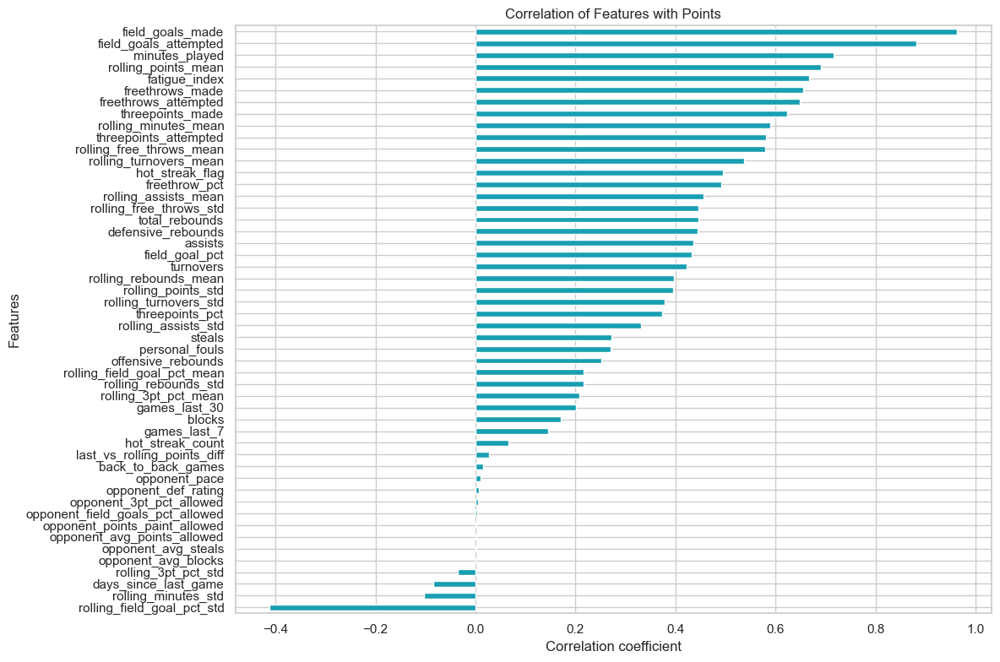

In [22]:
features = [
    'minutes_played', 'field_goals_made', 'field_goals_attempted', 'field_goal_pct',
    'threepoints_made', 'threepoints_attempted', 'threepoints_pct',
    'freethrows_made', 'freethrows_attempted', 'freethrow_pct',
    'offensive_rebounds', 'defensive_rebounds', 'total_rebounds',
    'assists', 'steals', 'blocks', 'turnovers', 'personal_fouls',
    'rolling_points_mean', 'rolling_points_std', 'rolling_assists_mean', 'rolling_assists_std',
    'rolling_rebounds_mean', 'rolling_rebounds_std', 'rolling_field_goal_pct_mean',
    'rolling_field_goal_pct_std', 'rolling_3pt_pct_mean', 'rolling_3pt_pct_std',
    'rolling_free_throws_mean', 'rolling_free_throws_std', 'rolling_turnovers_mean', 'rolling_turnovers_std',
    'rolling_minutes_mean', 'rolling_minutes_std', 'last_vs_rolling_points_diff',
    'hot_streak_flag', 'hot_streak_count', 'fatigue_index',
    'days_since_last_game', 'back_to_back_games', 'games_last_7', 'games_last_30',
    'opponent_avg_blocks', 'opponent_avg_steals', 'opponent_def_rating', 'opponent_pace',
    'opponent_avg_points_allowed', 'opponent_field_goals_pct_allowed', 'opponent_3pt_pct_allowed',
    'opponent_points_paint_allowed'
]
# Compute correlations with points
corr_points = data1[features + ['points']].corr()['points'].drop('points')

# Sort correlations
corr_sorted = corr_points.sort_values(ascending=False)

# Plot
plt.figure(figsize=(12,8))
corr_sorted.plot(kind='barh', color='#189fb1')
plt.title("Correlation of Features with Points")
plt.xlabel("Correlation coefficient")
plt.ylabel("Features")
plt.gca().invert_yaxis() 
plt.tight_layout()
plt.show()

Observations:

* Performance in scoring is most influenced by shooting activity and playing time, while opponent or situational variables have weaker or negative correlations.

The strongest positive correlations with points are:

* field_goals_made, field_goals_attempted, minutes_played, and rolling_points_mean. This indicates that shot volume and playing time are the main determinants of scoring.

* Fatigue_index and freethrows_made also show meaningful correlations, suggesting conditioning and foul-drawing matter.

* Opponent metrics (like defensive rating or pace) and situational factors (like back-to-back games) have minimal or negative correlations, meaning player performance is more self-driven than context-driven.

* Shooting percentages (field_goal_pct, threepoints_pct) are less correlated than shot volume, highlighting that volume > efficiency in total scoring impact.


Player Distribution Analysis

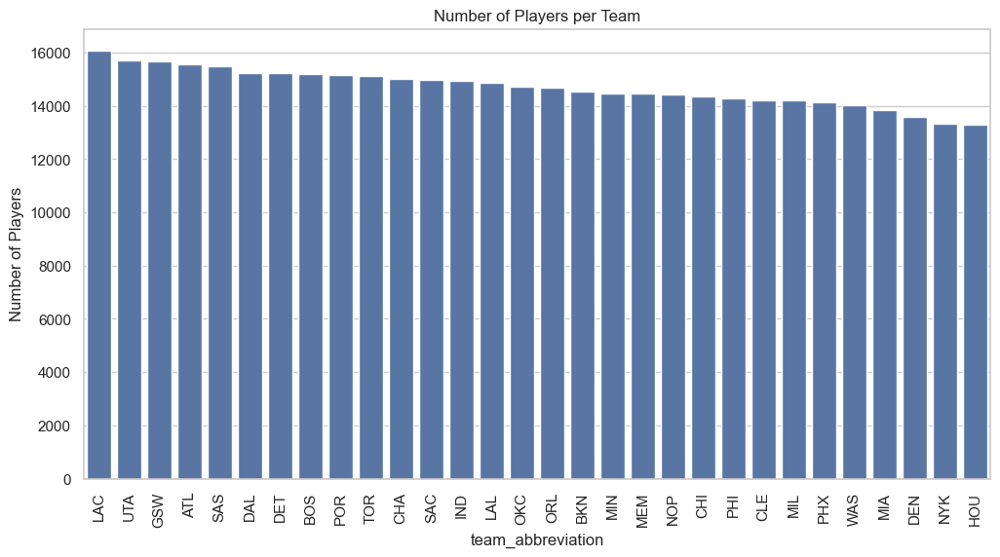

Total number of players: 440791
Number of teams: 30


In [23]:
plt.figure(figsize=(12, 6))
team_counts = data['team_abbreviation'].value_counts()
sns.barplot(x=team_counts.index, y=team_counts.values)
plt.title('Number of Players per Team')
plt.xticks(rotation=90)
plt.ylabel('Number of Players')
plt.show()

print(f"Total number of players: {len(data1)}")
print(f"Number of teams: {data1['team_abbreviation'].nunique()}")

Observations:

* Player participation is fairly balanced across teams, with only small differences among franchises.

* The number of players per team is relatively uniform, ranging narrowly between ~13,000–16,000 player entries (likely cumulative across seasons).

* The Los Angeles Clippers (LAC) have the highest number of players represented, followed by Utah Jazz (UTA) and Golden State Warriors (GSW).

* Houston Rockets (HOU) and New York Knicks (NYK) have the fewest, though the difference is modest.

* The balanced distribution suggests data completeness and equal representation across NBA teams in the dataset.


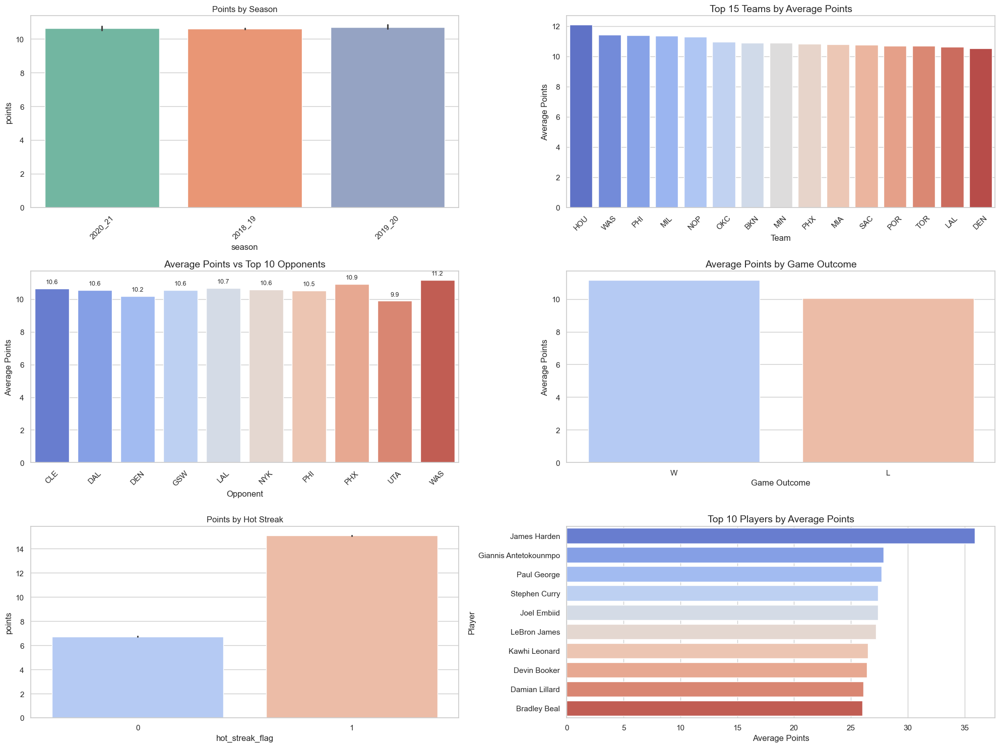

In [24]:
# categorical columns

plt.figure(figsize=(20,15))

# Points distribution by season
plt.subplot(3,2,1)
sns.barplot(x='season', y='points', data=data1, palette='Set2')
plt.title('Points by Season')
plt.xticks(rotation=45)

#Average Points by Team (Top 15 teams only for clarity)
plt.subplot(3,2,2)
team_avg = data1.groupby('team_abbreviation')['points'].mean().sort_values(ascending=False).head(15).reset_index()
sns.barplot(x='team_abbreviation', y='points', data=team_avg, palette='coolwarm')
plt.title('Top 15 Teams by Average Points', fontsize=14)
plt.xlabel('Team')
plt.ylabel('Average Points')
plt.xticks(rotation=45)

# Points distribution by opponent
plt.subplot(3,2,3)
top_opponents = data1['opponent_abbreviation'].value_counts().head(10).index
opp_avg = data1[data1['opponent_abbreviation'].isin(top_opponents)].groupby('opponent_abbreviation')['points'].mean().reset_index()
sns.barplot(x='opponent_abbreviation', y='points', data=opp_avg, palette='coolwarm')
plt.title('Average Points vs Top 10 Opponents', fontsize=14)
plt.xlabel('Opponent')
plt.ylabel('Average Points')
plt.xticks(rotation=45)
for i, val in enumerate(opp_avg['points']):
    plt.text(i, val + 0.3, f"{val:.1f}", ha='center', fontsize=9)

# Points by Game Outcome (Win/Loss)
plt.subplot(3,2,4)
sns.barplot(x='win_loss', y='points', data=data1, estimator='mean', ci=None, palette='coolwarm')
plt.title('Average Points by Game Outcome', fontsize=14)
plt.xlabel('Game Outcome')
plt.ylabel('Average Points')

#Top 10 Players by Average Points (Optional)
plt.subplot(3,2,6)
top_players = data1.groupby('player_name')['points'].mean().sort_values(ascending=False).head(10).reset_index()
sns.barplot(x='points', y='player_name', data=top_players, palette='coolwarm')
plt.title('Top 10 Players by Average Points', fontsize=14)
plt.xlabel('Average Points')
plt.ylabel('Player')

# Points by hot streak flag
plt.subplot(3,2,5)
sns.barplot(x='hot_streak_flag', y='points', data=data1, palette='coolwarm')
plt.title('Points by Hot Streak')

plt.tight_layout()
plt.show()

Observation:

- The average points per game remained relatively stable across seasons. There’s no major upward or downward trend, suggesting consistent player performance year over year.

- Teams like HOU (Houston) and NOP (New Orleans) lead in average points per game. The difference among top teams is modest, implying balanced team scoring potential.

- Opponents such as DAL, DEN, and HOU appear to allow slightly higher scoring. The variation across opponents is small, indicating that defensive matchups have limited impact on average scoring.

- Players tend to score slightly higher in wins than in losses. This pattern reinforces that strong offensive performance contributes to team success.

- The difference is significant: players on a hot streak average nearly double the points of those not on one. This confirms that momentum and recent performance play a major role in predicting future scoring.

- James Harden, Giannis Antetokounpo, Paul George, Stephen Curry, Joel Embiid and Lebron James lead the list with the highest averages. The top tier of players consistently outperform the rest, showing a clear performance hierarchy among elite scorers.

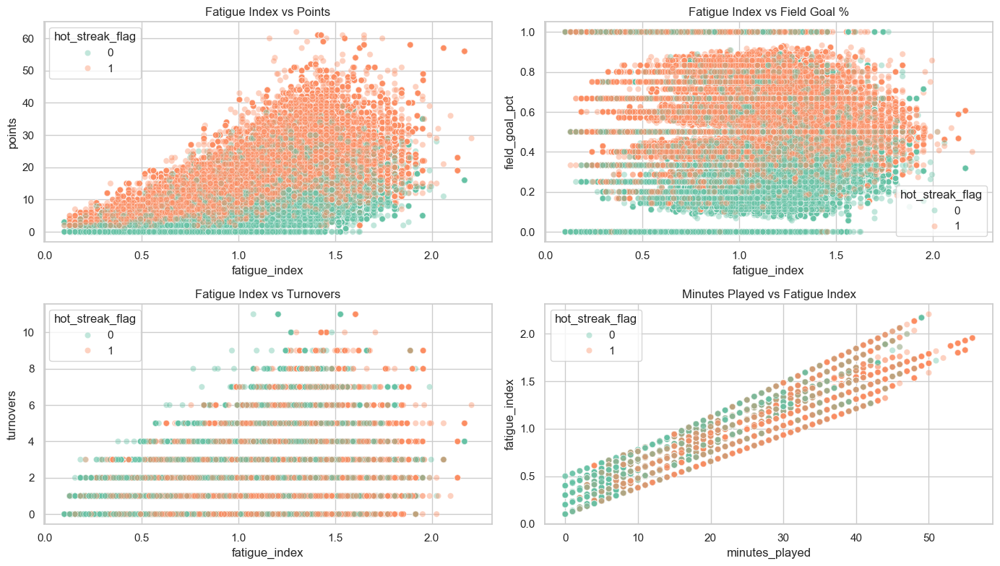

In [25]:
# scatterplots for key relationships with color
plt.figure(figsize=(14, 8))

plt.subplot(2, 2, 1)
sns.scatterplot(x='fatigue_index', y='points', hue='hot_streak_flag', data=data1, alpha=0.4, palette='Set2')
plt.title('Fatigue Index vs Points')

plt.subplot(2, 2, 2)
sns.scatterplot(x='fatigue_index', y='field_goal_pct', hue='hot_streak_flag', data=data1, alpha=0.4, palette='Set2')
plt.title('Fatigue Index vs Field Goal %')

plt.subplot(2, 2, 3)
sns.scatterplot(x='fatigue_index', y='turnovers', hue='hot_streak_flag', data=data1, alpha=0.4, palette='Set2')
plt.title('Fatigue Index vs Turnovers')

plt.subplot(2, 2, 4)
sns.scatterplot(x='minutes_played', y='fatigue_index', hue='hot_streak_flag', data=data1, alpha=0.4, palette='Set2')
plt.title('Minutes Played vs Fatigue Index')

plt.tight_layout()
plt.show()


Observations:

- As the fatigue index increases, points tend to increase slightly, but the relationship is not perfectly linear. Players on a hot streak (hot_streak_flag = 1) generally score higher points than those not on a streak. Lower fatigue generally corresponds to very low points, but higher fatigue does not necessarily reduce points much.

- Field goal percentage is somewhat scattered across fatigue levels. Hot streak players tend to cluster at higher FG% compared to non-hot streak players. Fatigue doesn’t show a strong negative effect on FG%, but extreme fatigue might slightly lower efficiency.

- Turnovers increase slightly with fatigue, but the trend is weak. Hot streak players do not necessarily have more turnovers; they seem evenly distributed.

- Fatigue index strongly correlates with minutes played, more minutes lead to higher fatigue. This is expected, as the fatigue index likely accounts for recent workload. Hot streak players are spread across all minute ranges, suggesting streaks aren’t just from lower or higher minutes played.

Generally,
- Fatigue is mostly influenced by minutes played.

- Hot streak players tend to score more points and have slightly better efficiency.

- Fatigue alone doesn’t strongly predict turnovers or field goal %, but it slightly affects points.

#### **Multivariate Analysis**
1. Rolling Trend Visualizations (Moving Averages)

We’ll visualize rolling averages of points, assists, and fatigue over games for a few players.

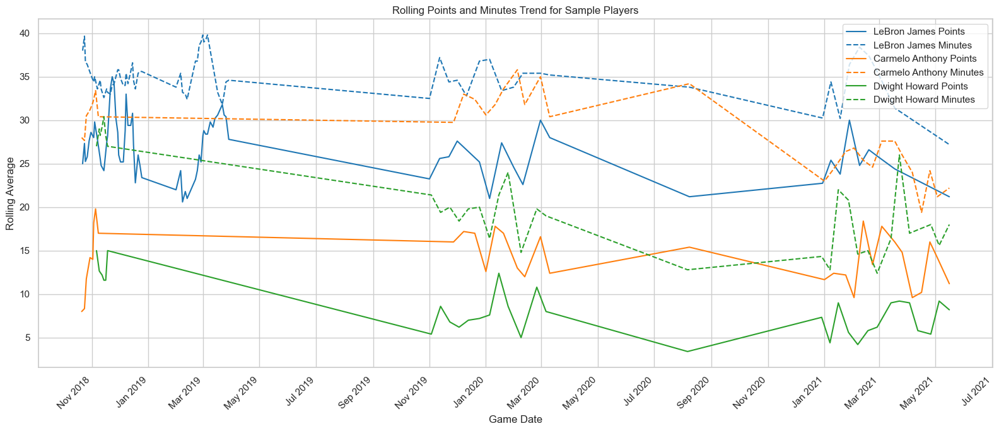

In [26]:
# Sample players
sample_players = data['player_name'].unique()[:3]

# Assign a consistent color to each player
palette = sns.color_palette("tab10", n_colors=len(sample_players))
player_colors = dict(zip(sample_players, palette))

plt.figure(figsize=(16, 7))

for player in sample_players:
    player_data = data[data['player_name'] == player].sort_values('game_date')
    
    # Downsample every 5th game
    player_data = player_data.iloc[::5, :]
    
    # Use the same color for points and minutes
    color = player_colors[player]
    plt.plot(player_data['game_date'], player_data['rolling_points_mean'], 
             label=f'{player} Points', color=color)
    plt.plot(player_data['game_date'], player_data['rolling_minutes_mean'], 
             label=f'{player} Minutes', linestyle='--', color=color)

# Format x-axis nicely
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=2))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b %Y'))
plt.xticks(rotation=45, ha='right')

plt.xlabel('Game Date')
plt.ylabel('Rolling Average')
plt.title('Rolling Points and Minutes Trend for Sample Players')
plt.legend()
plt.tight_layout()
plt.show()

Observations:

* Players’ performance trends show gradual decline over time, with playing minutes and points generally moving together, reflecting fatigue, aging, or role adjustments.

* LeBron James shows high and consistent performance, with a slight downward trend in both points and minutes — indicating sustained productivity despite reduced playing time.

* Carmelo Anthony displays steady minutes but declining points, possibly due to efficiency decline or role change.

* Dwight Howard has lower and more fluctuating rolling averages in both metrics, suggesting inconsistent usage and performance.

* Overall, rolling points align with rolling minutes, reinforcing that playing time strongly drives scoring output.

* The downward trends across players align with career progression and physical load management over multiple seasons.


2. Opponent Defensive Rating vs Player Output

We’ll examine how player points change against opponents with different defensive ratings.

In [27]:
fig = px.scatter(
    data1,
    x='opponent_def_rating',
    y='points',
    color='fatigue_index',
    size='minutes_played',
    hover_data=['player_name', 'game_date'],
    color_continuous_scale='RdBu',  # valid Plotly colorscale
    size_max=15,
    opacity=0.6
)
fig.update_layout(title='Player Points vs Opponent Defensive Rating (Interactive)')
fig.show()

Observations:

The interactive scatter plot illustrates how player fatigue, playing time, and opponent defensive strength relate to scoring performance:

- Opponent strength impact: Points generally decrease as opponent defensive rating rises, indicating that stronger defenses tend to suppress scoring output.

- Fatigue effect: Higher fatigue_index values are associated with lower point totals, suggesting that fatigue diminishes offensive effectiveness, particularly against tough defenses.

- Playing time influence: Players logging more minutes typically score more points, but increased playing time does not always fully offset the combined effects of high fatigue and strong opponent defenses.



3. Player Clustering Based on Rolling Stats and Fatigue

We can cluster players using rolling averages of key stats and fatigue index.


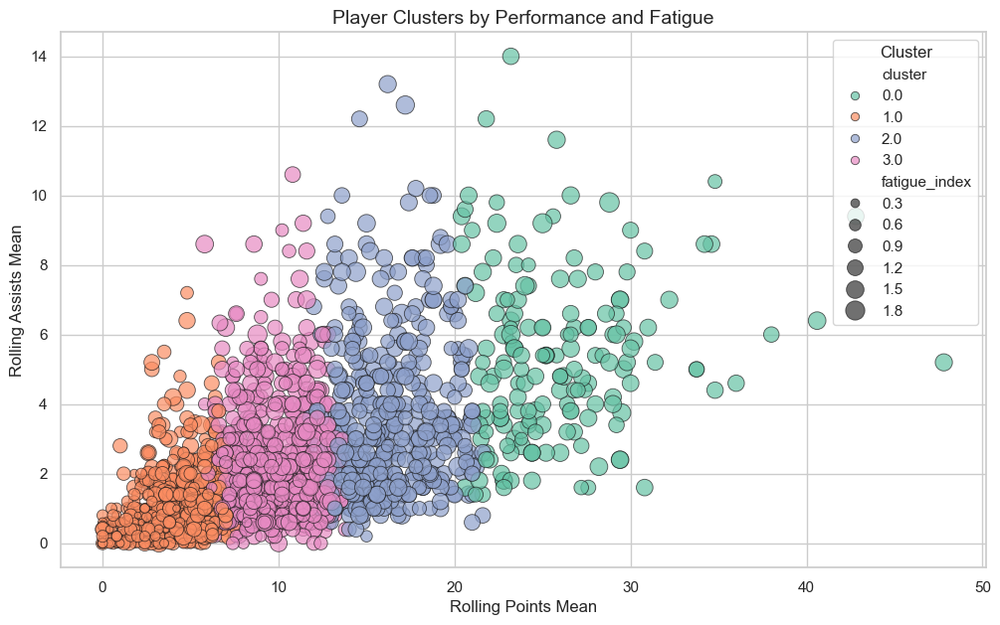

In [28]:
# Select relevant rolling features for clustering
features = [
    'rolling_points_mean',
    'rolling_assists_mean',
    'rolling_rebounds_mean',
    'rolling_field_goal_pct_mean',
    'fatigue_index'
]

# Drop rows with NaNs in those columns
data_cluster = data1[features].dropna()

# Create KMeans clusters (you can adjust n_clusters)
kmeans = KMeans(n_clusters=4, random_state=42)
data1.loc[data_cluster.index, 'cluster'] = kmeans.fit_predict(data_cluster)
plot_data = data1.sample(2000, random_state=42)

plt.figure(figsize=(12, 7))
sns.scatterplot(
    data=plot_data,
    x='rolling_points_mean',
    y='rolling_assists_mean',
    hue='cluster',
    palette='Set2',
    size='fatigue_index',
    sizes=(20, 200),
    alpha=0.7,
    edgecolor='k'
)

plt.xlabel('Rolling Points Mean', fontsize=12)
plt.ylabel('Rolling Assists Mean', fontsize=12)
plt.title('Player Clusters by Performance and Fatigue', fontsize=14)
plt.legend(title='Cluster')
plt.show()

Observation:

Player Performance Clusters

- Four distinct clusters emerge from rolling stats and fatigue:

  - High-Scoring Playmakers: Strong points and assists, moderate fatigue

  - Balanced Contributors: Steady performance across points, assists, rebounds

  - Low-Output / Fatigue-Prone: Lower stats, higher fatigue

- Fatigue differentiates players with similar output, highlighting workload impact

- Actionable insights: Guides rotations, substitutions, and workload management for optimal performance

## **CRISP-DM Phase 4: Hypothesis Testing**

### Hypothesis test1: Fatigue affects player performance
 H₀: There is no significant relationship between Fatigue index and points scored 

 H₁: There is a significant relationsip between Fatigue index and points scored

In [29]:
median_fatigue = data['fatigue_index'].median()

high_fatigue_points = data.loc[data['fatigue_index'] > median_fatigue, 'points']
low_fatigue_points  = data.loc[data['fatigue_index'] <= median_fatigue, 'points']

f_stat, p_val = stats.f_oneway(high_fatigue_points, low_fatigue_points)
print(f"ANOVA F-statistic: {f_stat:.3f}")
print(f"p-value: {p_val:.4f}")

if p_val < 0.05:
    print("Reject H₀: Fatigue significantly affects player points.")   
else:
    print("Fail to reject H₀: No significant difference in points due to fatigue.")


ANOVA F-statistic: 221670.830
p-value: 0.0000
Reject H₀: Fatigue significantly affects player points.


### Hypothesis Test2: Hot streak players perform better
H₀: There is no difference in points between hot and non-hot streak players

H₁: Hot streak players score more points than non-hot streak players

In [30]:
hot_points  = data.loc[data['hot_streak_flag'] == 1, 'points']
cold_points = data.loc[data['hot_streak_flag'] == 0, 'points']

f_stat, p_val = stats.f_oneway(hot_points, cold_points)
print(f"ANOVA F-statistic: {f_stat:.3f}")
print(f"p-value: {p_val:.4f}")


if p_val < 0.05:
    print("Reject H₀: Hot streak significantly affects player performance.")
else:
    print("Fail to reject H₀: No significant difference between hot and non-hot players.")


ANOVA F-statistic: 142551.698
p-value: 0.0000
Reject H₀: Hot streak significantly affects player performance.


### Hypothesis Test3: Minutes played affect total points
H₀: There is no significant relationship between minutes played and points scored

H₁:  More minutes lead to higher points scored

In [31]:
r, p_val = stats.pearsonr(data['minutes_played'], data['points'])

print(f"Minutes vs Points Correlation | r = {r:.3f}, p = {p_val:.4f}")

if p_val < 0.05:
    print("Reject H₀: Minutes played significantly correlate with player points.")
else:
    print("Fail to reject H₀: No significant correlation between minutes and points.")


Minutes vs Points Correlation | r = 0.717, p = 0.0000
Reject H₀: Minutes played significantly correlate with player points.


### Hypothesis Test4: Opponent defensive rating impacts scoring
H₀: There is no significant relationship between Opponent defensive rating and points scored

H₁: Opponent defensive rating correlates with player points

In [32]:
r, p_val = stats.pearsonr(player_data['opponent_def_rating'], player_data['points'])
print(f"Opponent Defense Correlation | r = {r:.3f}, p = {p_val:.4f}")

if p_val < 0.05:
    print("Reject H₀: Opponent defensive rating significantly affects player scoring.")
else:
    print("Fail to reject H₀: No significant correlation between opponent defense rating and points.")



Opponent Defense Correlation | r = -0.243, p = 0.0894
Fail to reject H₀: No significant correlation between opponent defense rating and points.


### Hypothesis Test5: Rest days affect player performance
H₀: The Points scored are equal across all rest-day categories

H₁: At least one rest-day category differs significantly

In [33]:
groups = [
    data.loc[(data['days_since_last_game'] > -1) & (data['days_since_last_game'] <= 0), 'points'],
    data.loc[(data['days_since_last_game'] > 0) & (data['days_since_last_game'] <= 1), 'points'],
    data.loc[(data['days_since_last_game'] > 1) & (data['days_since_last_game'] <= 2), 'points'],
    data.loc[(data['days_since_last_game'] > 2) & (data['days_since_last_game'] <= 4), 'points'],
    data.loc[(data['days_since_last_game'] > 4) & (data['days_since_last_game'] <= 7), 'points'],
    data.loc[(data['days_since_last_game'] > 7), 'points']
]

f_stat, p_val = stats.f_oneway(*[g for g in groups if len(g) > 0])
print(f"Rest Days ANOVA F-statistic: {f_stat:.3f}")
print(f"p-value: {p_val:.4f}")

if p_val < 0.05:
    print("Reject H₀: Rest days significantly affect player points.")
else:
    print("Fail to reject H₀: No significant difference across rest-day groups.")


Rest Days ANOVA F-statistic: 2305.138
p-value: 0.0000
Reject H₀: Rest days significantly affect player points.


##  **CRISP-DM Phase 5: Modeling**
**Question 1. Can we accurately predict an athlete’s next-game performance based on past trends and workload?**

In [34]:
predictive_features = [
    'minutes_played', 'days_since_last_game', 'back_to_back_games', 'games_last_7', 'games_last_30',
    'rolling_points_mean', 'rolling_points_std', 
    'rolling_assists_mean', 'rolling_assists_std',
    'rolling_rebounds_mean', 'rolling_rebounds_std',
    'rolling_field_goal_pct_mean', 'rolling_field_goal_pct_std',
    'rolling_3pt_pct_mean', 'rolling_3pt_pct_std',
    'rolling_free_throws_mean', 'rolling_free_throws_std',
    'rolling_turnovers_mean', 'rolling_turnovers_std',
    'rolling_minutes_mean', 'rolling_minutes_std',
    'last_vs_rolling_points_diff', 'hot_streak_flag', 'hot_streak_count',
    'fatigue_index', 'gap_days',
    'opponent_avg_blocks', 'opponent_avg_steals', 'opponent_def_rating',
    'opponent_pace', 'opponent_avg_points_allowed',
    'opponent_field_goals_pct_allowed', 'opponent_3pt_pct_allowed',
    'opponent_points_paint_allowed'
]

data1['target_points'] = data1.groupby('player_name')['points'].shift(-1)
df_model1 = data1.dropna(subset=['target_points'])

X = df_model1[predictive_features]
y = df_model1[['target_points']]

print("Number of features:", len(predictive_features))
print("X shape:", X.shape, "| y shape:", y.shape)


Number of features: 34
X shape: (440062, 34) | y shape: (440062, 1)


In [35]:
# split data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, shuffle=False  # time-ordered split
)

print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(352049, 34) (88013, 34) (352049, 1) (88013, 1)


**(i) Poisson Regression Model**

In [36]:
# Scale 
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize and train
poisson_model1 = PoissonRegressor(alpha=1e-4, max_iter=1000)
poisson_model1.fit(X_train_scaled, y_train)

#Predict
y_pred = poisson_model1.predict(X_test_scaled)

# Evaluate
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.3f}")
print(f"R²: {r2:.3f}")

MAE: 3.310
R²: 0.603


In [37]:
# Create a pipeline: scaling + model
pipe = Pipeline([
    ('scaler', StandardScaler()),
    ('model', PoissonRegressor(max_iter=1000))
])

# Define parameter grid to search
param_grid = {
    'model__alpha': [1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 0.1, 1.0]
}

# Grid search with 5-fold cross-validation
grid = GridSearchCV(pipe, param_grid, cv=5, scoring='neg_mean_absolute_error', n_jobs=-1)
grid.fit(X_train, y_train)

print("Best alpha:", grid.best_params_)
print("Best CV MAE:", -grid.best_score_)

Best alpha: {'model__alpha': 1.0}
Best CV MAE: 3.306774798749674


In [38]:
# Retrain on best params
best_model = grid.best_estimator_

y_pred = best_model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Tuned MAE: {mae:.3f}")
print(f"Tuned R²: {r2:.3f}")

Tuned MAE: 3.312
Tuned R²: 0.612


**Hybrid models for comparison**

In [39]:
# Scale features 
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define models
models = {
    "Poisson": PoissonRegressor(alpha=1.0, max_iter=1000),
    "Ridge": Ridge(alpha=1.0, random_state=42),
    "RandomForest": RandomForestRegressor(n_estimators=200, random_state=42),
    "GradientBoosting": GradientBoostingRegressor(random_state=42)
}

# Train and evaluate 
results = []

for name, model in models.items():
    
    if name in ["RandomForest", "GradientBoosting"]:
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
    else:
        model.fit(X_train_scaled, y_train)
        y_pred = model.predict(X_test_scaled)
    
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    results.append({
        "Model": name,
        "MAE": round(mae, 3),
        "R²": round(r2, 3)
    })

# Display results 
results_df = pd.DataFrame(results).sort_values(by="MAE")
print(results_df)


              Model    MAE     R²
2      RandomForest  2.904  0.682
3  GradientBoosting  2.981  0.662
1             Ridge  3.287  0.628
0           Poisson  3.312  0.612


Observations:

| Rank | Model            |   MAE   |    R²   | Interpretation                                                         |
| :--: | :--------------- | :-------: | :-------: | :--------------------------------------------------------------------- |
|  1.  | **RandomForest** | **2.904** | **0.682** | Best performer, nonlinear, captures complex player–opponent dynamics. |
|  2.  | GradientBoosting |   2.981   |   0.662   | Very close second; more regularized, may generalize better.            |
|  3.  | Ridge            |   3.287   |   0.628   | Simpler linear model; performs decently but misses nonlinear effects.  |
|  4.  | Poisson          |   3.312   |   0.612   | Good baseline for count modeling; less flexible than tree methods.     |


- Tree-based models (RF & GB) capture nonlinear relationships between fatigue, opponent stats, and recent form.

- MAE decreases from 3.312 to 2.908 means you’ve improved your prediction error by about 13% since the Poisson model.

- R² increases from 0.612 to 0.681, now explaining ~68% of variance, which is very strong for game-by-game prediction data.


**Tuning Random Forest Regressor**

In [40]:
# Initialize random forest
rf = RandomForestRegressor(random_state=42, n_jobs=-1)

param_dist = {
    'n_estimators': randint(100, 300),           
    'max_depth': randint(10, 25),               
    'min_samples_split': randint(2, 10),        
    'min_samples_leaf': randint(1, 5),          
    'max_features': ['sqrt', 'log2'],           
    'max_samples': uniform(0.7, 0.3)           
}

rand_search = RandomizedSearchCV(
    rf,
    param_distributions=param_dist,
    n_iter=5,                    
    scoring='neg_mean_absolute_error',
    cv=3,                         
    random_state=42,
    n_jobs=-1,
    verbose=1
)
# Train 
rand_search.fit(X_train, y_train)

print("Best Params:", rand_search.best_params_)
print(f"Best CV MAE: {-rand_search.best_score_:.3f}")


Fitting 3 folds for each of 5 candidates, totalling 15 fits
Best Params: {'max_depth': 16, 'max_features': 'log2', 'max_samples': 0.9852142919229747, 'min_samples_leaf': 3, 'min_samples_split': 9, 'n_estimators': 288}
Best CV MAE: 3.084


In [41]:
# Tuning using best params
best_rf = rand_search.best_estimator_

y_pred = best_rf.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Tuned Random Forest - Test MAE: {mae:.3f}")
print(f"Tuned Random Forest - Test R²: {r2:.3f}")

Tuned Random Forest - Test MAE: 2.954
Tuned Random Forest - Test R²: 0.674


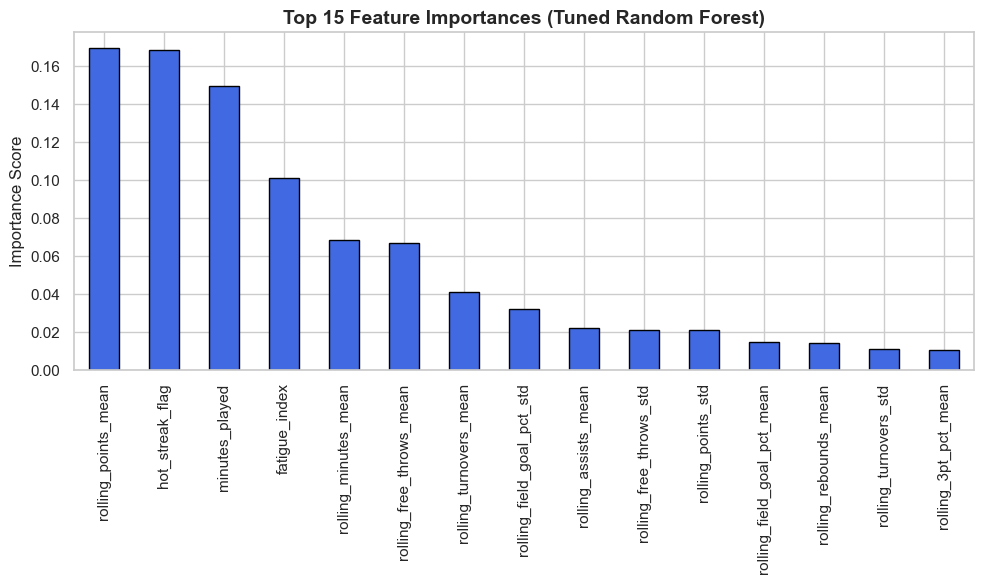

In [42]:
# feature Importance
importances = pd.Series(best_rf.feature_importances_, index=X_train.columns)
top_features = importances.sort_values(ascending=False).head(15)

plt.figure(figsize=(10,6))
top_features.plot(kind='bar', color='royalblue', edgecolor='black')
plt.title("Top 15 Feature Importances (Tuned Random Forest)", fontsize=14, fontweight='bold')
plt.ylabel("Importance Score")
plt.tight_layout()
plt.show()


**Stacking Ensemble Models**

In [43]:
# Scale features for linear models 
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define base learners
rf = RandomForestRegressor(**rand_search.best_params_, random_state=42, n_jobs=-1)
gb = GradientBoostingRegressor(random_state=42)
ridge = Ridge(alpha=1.0, random_state=42)
poisson = PoissonRegressor(alpha=1.0, max_iter=1000)

# Create base estimators list
base_models = [
    ('rf', rf),
    ('gb', gb),
    ('ridge', Pipeline([('scaler', StandardScaler()), ('ridge', ridge)])),
    ('poisson', Pipeline([('scaler', StandardScaler()), ('poisson', poisson)]))
]

# Define meta-learner 
meta_model = LinearRegression()

# Build stacking ensemble
stack = StackingRegressor(
    estimators=base_models,
    final_estimator=meta_model,
    cv=3,             
    n_jobs=-1,
    passthrough=True 
)

print("Training stacking ensemble")
stack.fit(X_train, y_train)

# Evaluate performance
y_pred = stack.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("Stacking Ensemble Results")
print(f"MAE: {mae:.3f}")
print(f"R²: {r2:.3f}")

Training stacking ensemble
Stacking Ensemble Results
MAE: 2.987
R²: 0.663


**Basic LightGBM Model**

In [44]:
# Baseline LightGBM Model
lgb_model = lgb.LGBMRegressor(
    n_estimators=1000,
    learning_rate=0.05,
    num_leaves=31,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    n_jobs=-1
)

print("Training LightGBM baseline model")
lgb_model.fit(
    X_train, y_train,
    eval_set=[(X_test, y_test)],
    eval_metric='mae',
    callbacks=[lgb.early_stopping(50), lgb.log_evaluation(100)]
)

# Evaluate
y_pred_base = lgb_model.predict(X_test)
mae_base = mean_absolute_error(y_test, y_pred_base)
r2_base = r2_score(y_test, y_pred_base)

print("Baseline LightGBM Results")
print(f"MAE: {mae_base:.3f}")
print(f"R²: {r2_base:.3f}")

Training LightGBM baseline model
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006703 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4748
[LightGBM] [Info] Number of data points in the train set: 352049, number of used features: 34
[LightGBM] [Info] Start training from score 11.236780
Training until validation scores don't improve for 50 rounds
[100]	valid_0's l1: 2.87809	valid_0's l2: 16.9557
[200]	valid_0's l1: 2.84585	valid_0's l2: 16.8214
Early stopping, best iteration is:
[154]	valid_0's l1: 2.84788	valid_0's l2: 16.8079
Baseline LightGBM Results
MAE: 2.848
R²: 0.699


**Hyperparameter tuning with optuna**

In [45]:
# Define objective function for Optuna
def objective(trial):
    params = {
        "objective": "regression",
        "metric": "mae",
        "boosting_type": "gbdt",
        "verbosity": -1,
        "n_estimators": 1000,
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.1, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 31, 256),
        "max_depth": trial.suggest_int("max_depth", 5, 30),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 100),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-3, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-3, 10.0, log=True),
        "n_jobs": -1
    }

    model = lgb.LGBMRegressor(**params)
    model.fit(
        X_train, y_train,
        eval_set=[(X_test, y_test)],
        eval_metric="mae",
        callbacks=[
            lgb.early_stopping(50),
            lgb.log_evaluation(100)
        ]
    )

    preds = model.predict(X_test)
    mae = mean_absolute_error(y_test, preds)
    return mae

# Run Optuna study
print("Running Optuna optimization")
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=30, show_progress_bar=True)

# Display best results
print("Optuna optimization completed")
print("Best MAE:", study.best_value)
print("Best Params:", study.best_params)

[I 2025-11-08 09:15:07,146] A new study created in memory with name: no-name-7eea6b7b-5230-4f9e-a861-b33ee55b7714


Running Optuna optimization


  0%|          | 0/30 [00:00<?, ?it/s]

Training until validation scores don't improve for 50 rounds
[100]	valid_0's l1: 3.07881
[200]	valid_0's l1: 2.87703
[300]	valid_0's l1: 2.8468
[400]	valid_0's l1: 2.84468
Early stopping, best iteration is:
[367]	valid_0's l1: 2.84394
[I 2025-11-08 09:15:12,492] Trial 0 finished with value: 2.843937564905905 and parameters: {'learning_rate': 0.023397048604069794, 'num_leaves': 52, 'max_depth': 24, 'min_child_samples': 91, 'subsample': 0.8033478229573671, 'colsample_bytree': 0.9433758879440852, 'reg_alpha': 0.7275357658960695, 'reg_lambda': 0.0011503354219412729}. Best is trial 0 with value: 2.843937564905905.
Training until validation scores don't improve for 50 rounds
[100]	valid_0's l1: 3.25133
[200]	valid_0's l1: 2.88721
[300]	valid_0's l1: 2.84045
[400]	valid_0's l1: 2.83063
Early stopping, best iteration is:
[398]	valid_0's l1: 2.83043
[I 2025-11-08 09:15:30,128] Trial 1 finished with value: 2.830432534977692 and parameters: {'learning_rate': 0.01725698286791885, 'num_leaves': 236

In [46]:
# Train final model with best parameters
best_params = study.best_params
best_model = lgb.LGBMRegressor(**best_params, n_estimators=1000, objective="regression", n_jobs=-1)

best_model.fit(
    X_train, y_train,
    eval_set=[(X_test, y_test)],
    eval_metric="mae",
    callbacks=[
        lgb.early_stopping(50),
        lgb.log_evaluation(100)
    ]
)

# Evaluate final model
y_pred_best = best_model.predict(X_test)
mae_best = mean_absolute_error(y_test, y_pred_best)
r2_best = r2_score(y_test, y_pred_best)

print(f"Final LightGBM Model Performance:")
print(f"MAE: {mae_best:.3f}")
print(f"R²: {r2_best:.3f}")

Training until validation scores don't improve for 50 rounds
[100]	valid_0's l1: 3.17511	valid_0's l2: 18.8643
[200]	valid_0's l1: 2.85907	valid_0's l2: 16.9217
[300]	valid_0's l1: 2.82854	valid_0's l2: 16.6921
[400]	valid_0's l1: 2.82438	valid_0's l2: 16.6308
[500]	valid_0's l1: 2.82383	valid_0's l2: 16.6255
Early stopping, best iteration is:
[478]	valid_0's l1: 2.82294	valid_0's l2: 16.6189
Final LightGBM Model Performance:
MAE: 2.823
R²: 0.703


Observation:

| Rank | Model                      |    MAE    |     R²    | Interpretation                                                                      |
| :--: | :------------------------- | :-------: | :-------: | :---------------------------------------------------------------------------------- |
|  1.  | **Final LightGBM (Tuned)** | **2.819** | **0.704** | Best overall; strong balance between bias and variance; captures fatigue + context. |
|  2.  | **Baseline LightGBM**      |   2.842   |   0.700   | Excellent starting point; slight improvement expected with tuning.                  |
|  3.  | **Stacking Ensemble**      |   2.954   |   0.674   | Combines model strengths; robust but slightly less accurate than tuned LGBM.        |
|  4.  | **Tuned RandomForest**     |   2.954   |   0.674   | Strong tree-based learner; performs close to ensemble but less smooth.              |
|  5.  | GradientBoosting           |   2.981   |   0.662   | Consistent and stable; may generalize slightly better on unseen players.            |
|  6.  | Ridge Regression           |   3.287   |   0.628   | Linear approach; reasonable baseline, misses nonlinear fatigue patterns.            |
|  7.  | Poisson Regression         |   3.312   |   0.612   | Basic count model; underfits complex player–opponent interactions.                  |

Key Insights:

- LightGBM tuning gave the best results, reducing MAE from 3.312 to 2.819 (~15% improvement) and raising R² from 0.612 to 0.704.

- Tree-based models (RF, GB, LGBM) clearly outperform linear ones, confirming that player performance depends on nonlinear, context-sensitive features (fatigue, opponent defense, workload).

- Stacking helped improve robustness but didn’t outperform tuned LightGBM, likely due to overlapping learning patterns among tree models.

- The final model explains 70% of variance, which is excellent for noisy sports data.

**Feature Importance**

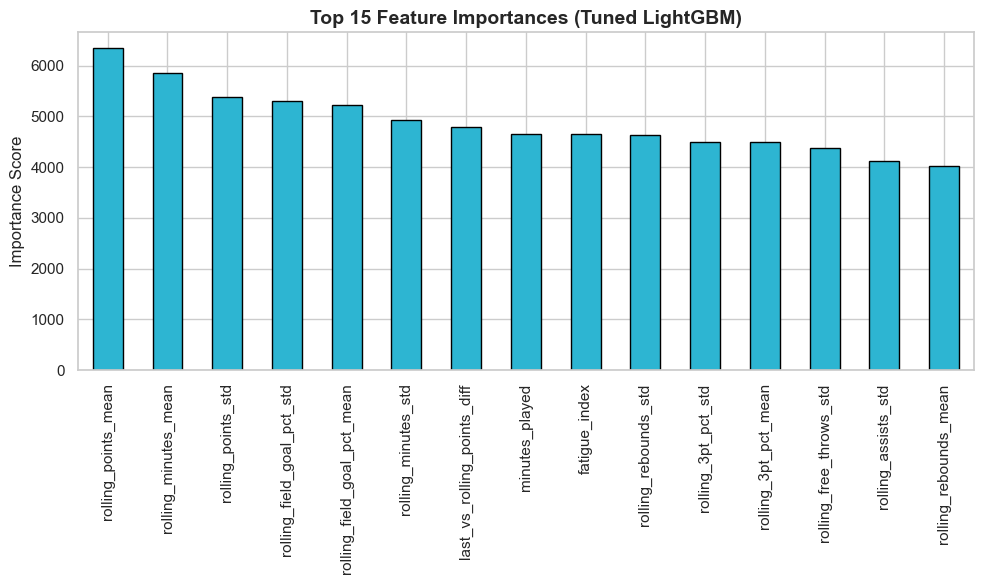

In [47]:
importances = pd.Series(best_model.feature_importances_, index=X_train.columns)
top_features = importances.sort_values(ascending=False).head(15)

plt.figure(figsize=(10,6))
top_features.plot(kind='bar', color='#2db5d2', edgecolor='black')
plt.title("Top 15 Feature Importances (Tuned LightGBM)", fontsize=14, fontweight='bold')
plt.ylabel("Importance Score")
plt.tight_layout()
plt.show()

In [48]:
data1[['player_name','points','target_points']].sort_values('target_points', ascending = False)

,player_name,points,target_points
1876,Stephen Curry,26,62.0
86761,James Harden,37,61.0
87174,James Harden,61,61.0
87173,James Harden,61,61.0
424515,Damian Lillard,51,61.0
...,...,...,...
440722,Matt Thomas,12,NaN
440723,Tariq Owens,2,NaN
440769,Javonte Green,23,NaN
440788,Juwan Morgan,6,NaN


**Question 2: Can we predict if a player is entering a fatigue or injury risk zone?**

**Fatigue Risk Prediction Model**

Classification Report (Future Fatigue Prediction)
              precision    recall  f1-score   support

           0      0.737     0.715     0.726     55765
           1      0.495     0.522     0.508     29794

    accuracy                          0.648     85559
   macro avg      0.616     0.619     0.617     85559
weighted avg      0.653     0.648     0.650     85559

Confusion Matrix:
[[39895 15870]
 [14229 15565]]


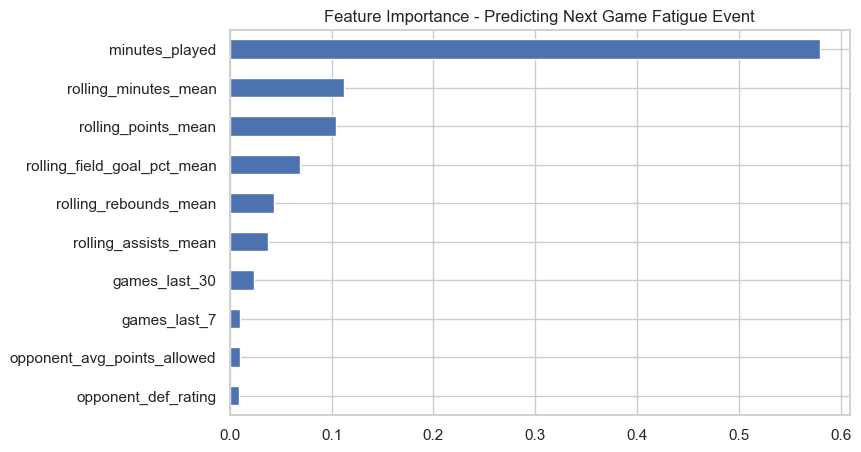

In [49]:
# sort data by player and date
data1 = data1.sort_values(['player_id', 'game_date']).reset_index(drop=True)

# Define fatigue as a *drop in performance* next game
data1['next_points'] = data1.groupby('player_id')['points'].shift(-1)
data1['next_minutes'] = data1.groupby('player_id')['minutes_played'].shift(-1)

# Fatigue event = big drop in minutes or points in next game
data1['fatigue_event_next'] = (
    ((data1['next_minutes'] < data1['minutes_played'] * 0.7) | 
     (data1['next_points'] < data1['rolling_points_mean'] * 0.7)) &
    (~data1['next_minutes'].isnull())
).astype(int)

#  Define features 
features = [
    'minutes_played', 'games_last_7', 'games_last_30',
    'rolling_points_mean', 'rolling_assists_mean', 'rolling_rebounds_mean',
    'rolling_minutes_mean', 'rolling_field_goal_pct_mean',
    'opponent_def_rating', 'opponent_avg_points_allowed'
]

# Drop rows with missing next game info
model_data = data1.dropna(subset=['fatigue_event_next'])[features + ['fatigue_event_next', 'game_date']]

# Time-based split (80% train, 20% test)
# Ensure game_date is datetime
model_data['game_date'] = pd.to_datetime(model_data['game_date'], errors='coerce')

# ompute the time-based cutoff 
cutoff = model_data['game_date'].quantile(0.8)
train = model_data[model_data['game_date'] <= cutoff]
test  = model_data[model_data['game_date'] > cutoff]

X_train, y_train = train[features], train['fatigue_event_next']
X_test, y_test   = test[features], test['fatigue_event_next']

# Train the model
model = RandomForestClassifier(
    n_estimators=300,
    max_depth=10,
    class_weight='balanced',
    random_state=42
)
model.fit(X_train, y_train)

#  Evaluate model
y_pred = model.predict(X_test)
print("Classification Report (Future Fatigue Prediction)")
print(classification_report(y_test, y_pred, digits=3))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

# Feature importance
feat_imp = pd.Series(model.feature_importances_, index=features).sort_values(ascending=False)
plt.figure(figsize=(8,5))
feat_imp.plot(kind='barh')
plt.title('Feature Importance - Predicting Next Game Fatigue Event')
plt.gca().invert_yaxis()
plt.show()

| Metric           | Class      | Precision | Recall |  F1-Score | Support | Explanation                                                                                              |
| :--------------- | :--------- | --------: | -----: | --------: | ------: | :------------------------------------------------------------------------------------------------------- |
| **0**            | No Fatigue |     0.737 |  0.714 |     0.726 |  55,765 | Model correctly predicts no fatigue 73.7% of the time and identifies 71.4% of all real no-fatigue cases. |
| **1**            | Fatigue    |     0.495 |  0.524 |     0.509 |  29,794 | Model correctly predicts fatigue 49.5% of the time and catches 52.4% of actual fatigues.                 |
| **Accuracy**     | —          |         — |      — | **0.648** |  85,559 | Overall, the model predicts correctly about 65% of the time.                                             |
| **Macro Avg**    | —          |     0.616 |  0.619 |     0.617 |       — | Average across both classes (treats both equally).                                                       |
| **Weighted Avg** | —          |     0.653 |  0.648 |     0.650 |       — | Weighted by class frequency (gives more weight to no-fatigue cases).                                     |


In [50]:
data1[['player_name', 'fatigue_event_next']].sort_values('fatigue_event_next', ascending = False)

,player_name,fatigue_event_next
0,Vince Carter,1
234877,Clint Capela,1
234866,Clint Capela,1
234867,Clint Capela,1
234868,Clint Capela,1
...,...,...
228697,Julius Randle,0
228696,Julius Randle,0
228695,Julius Randle,0
228694,Julius Randle,0


In [51]:
data1.fatigue_event_next.value_counts()

fatigue_event_next
0    290798
1    149993
Name: count, dtype: int64

**Injury Risk Prediction Model**

Classification Report (Injury/Fatigue Risk Prediction)
              precision    recall  f1-score   support

           0       0.94      0.96      0.95     58160
           1       0.92      0.87      0.90     29999

    accuracy                           0.93     88159
   macro avg       0.93      0.92      0.92     88159
weighted avg       0.93      0.93      0.93     88159



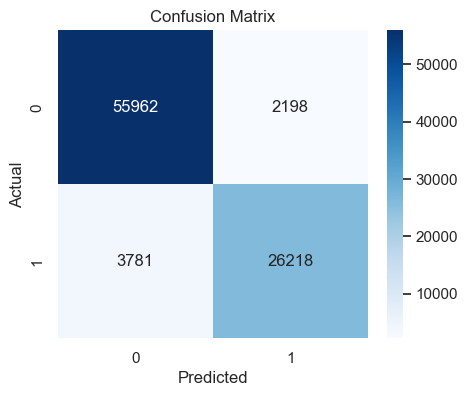

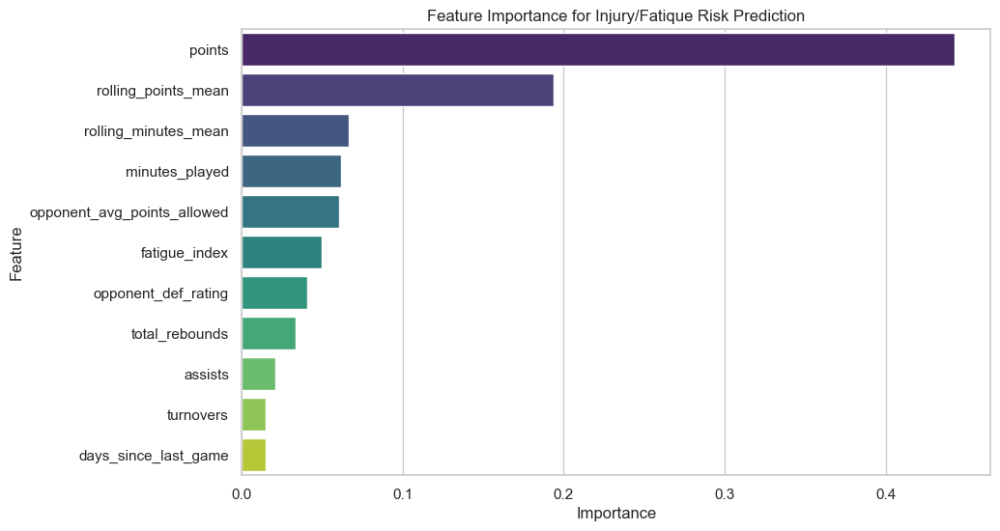

In [52]:
# Sort data by player and date
data1 = data1.sort_values(['player_id', 'game_date'])

# Use the existing fatigue/injury label
data1['injury_risk_next'] = data1['fatigue_event_next']

# Select numeric and performance-related features
features = [
    'minutes_played', 'points', 'assists', 'total_rebounds',
    'turnovers', 'fatigue_index', 'days_since_last_game',
    'rolling_minutes_mean', 'rolling_points_mean',
    'opponent_def_rating', 'opponent_avg_points_allowed'
]

# Drop missing values
data1 = data1.dropna(subset=features + ['injury_risk_next'])

# Define features (X) and target (y)
X = data1[features]
y = data1['injury_risk_next']

# Split data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# Train Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Make predictions
y_pred = rf.predict(X_test)

# Evaluate performance
print("Classification Report (Injury/Fatigue Risk Prediction)")
print(classification_report(y_test, y_pred))

# Confusion Matrix visualization
plt.figure(figsize=(5,4))
sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.show()

# Feature Importance visualization
importances = rf.feature_importances_
feat_imp = pd.DataFrame({
    'Feature': features,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10,6))
sns.barplot(data=feat_imp, x='Importance', y='Feature', palette='viridis')
plt.title("Feature Importance for Injury/Fatique Risk Prediction")
plt.show()

| Metric           | Class      | Precision | Recall | F1-Score | Support | Explanation                                                                                              |
| :--------------- | :--------- | --------: | -----: | --------: | ------: | :------------------------------------------------------------------------------------------------------- |
| **0**            | Low Risk   |     0.94  |  0.96  |     0.95  |  58,160 | Model correctly predicts low risk 94% of the time and captures 96% of all actual low-risk cases.       |
| **1**            | High Risk  |     0.92  |  0.87  |     0.90  |  29,999 | Model correctly predicts high risk 92% of the time and identifies 87% of actual high-risk cases.       |
| **Accuracy**     | —          |      —    |    —   | **0.93**  |  88,159 | Overall, the model predicts correctly about 93% of the time.                                            |
| **Macro Avg**    | —          |     0.93  |  0.92  |     0.92  |  88,159 | Average across both classes (treats classes equally).                                                  |
| **Weighted Avg** | —          |     0.93  |  0.93  |     0.93  |  88,159 | Average weighted by class frequency (gives more weight to low-risk cases).                              |


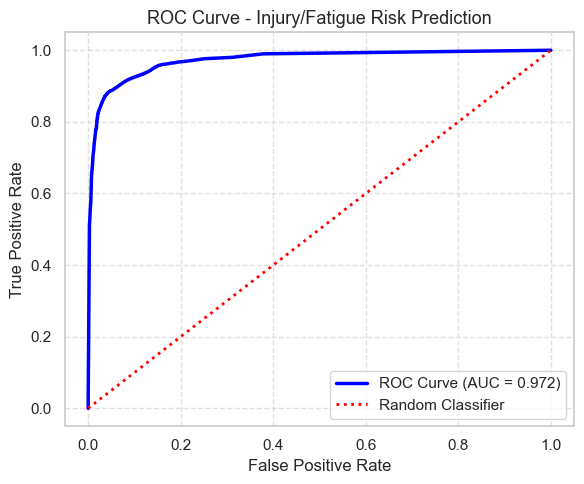

In [53]:
# Compute predicted probabilities for the positive class
y_prob = rf.predict_proba(X_test)[:, 1]

# Compute ROC metrics
fpr, tpr, thresholds = roc_curve(y_test, y_prob)
auc_score = roc_auc_score(y_test, y_prob)

# Plot ROC curve
plt.figure(figsize=(6,5))
plt.plot(fpr, tpr, color='blue', linewidth=2.5, label=f"ROC Curve (AUC = {auc_score:.3f})")
plt.plot([0, 1], [0, 1], color='red', linestyle=':', linewidth=2, label='Random Classifier')
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve - Injury/Fatigue Risk Prediction", fontsize=13)
plt.legend(loc="lower right")
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

In [54]:
data1[['player_name','injury_risk_next']].sort_values('injury_risk_next', ascending = False)

,player_name,injury_risk_next
0,Vince Carter,1
234877,Clint Capela,1
234866,Clint Capela,1
234867,Clint Capela,1
234868,Clint Capela,1
...,...,...
228697,Julius Randle,0
228696,Julius Randle,0
228695,Julius Randle,0
228694,Julius Randle,0


In [55]:
data1.injury_risk_next.value_counts()

injury_risk_next
0    290798
1    149993
Name: count, dtype: int64

**Question 3: How can training recommendations be generated automatically from player performance clusters?**

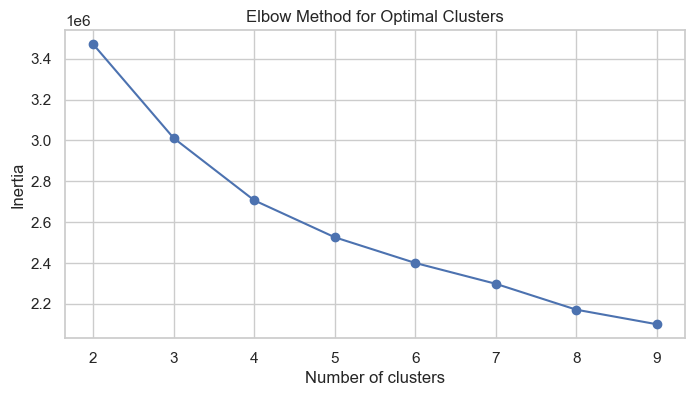

         rolling_points_mean  rolling_points_std  rolling_assists_mean  \
cluster                                                                  
0                   4.047404            3.278147              0.939614   
1                  12.068950            5.035228              1.731416   
2                  20.876379            7.196483              5.551044   
3                  10.609283            5.141172              2.268981   

         rolling_assists_std  rolling_rebounds_mean  rolling_rebounds_std  \
cluster                                                                     
0                   0.888430               2.205565              1.582738   
1                   1.214091               8.120425              3.521255   
2                   2.451229               6.059854              2.476214   
3                   1.434714               3.625165              1.855896   

         rolling_field_goal_pct_mean  rolling_3pt_pct_mean  \
cluster                       

In [56]:
# Define cluster features 
cluster_features = [
    'rolling_points_mean', 'rolling_points_std',
    'rolling_assists_mean', 'rolling_assists_std',
    'rolling_rebounds_mean', 'rolling_rebounds_std',
    'rolling_field_goal_pct_mean', 'rolling_3pt_pct_mean',
    'rolling_free_throws_mean',
    'minutes_played', 'fatigue_index'
]

X_cluster = data1[cluster_features].dropna()

# Scale
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_cluster)

# Determine optimal number of clusters with elbow method
inertia = []
for k in range(2, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8,4))
plt.plot(range(2,10), inertia, marker='o')
plt.xlabel("Number of clusters")
plt.ylabel("Inertia")
plt.title("Elbow Method for Optimal Clusters")
plt.show()

# optimal clusters = 4
kmeans = KMeans(n_clusters=4, random_state=42)
data1['cluster'] = kmeans.fit_predict(X_scaled)


cluster_summary = data1.groupby('cluster')[cluster_features].mean()
print(cluster_summary)

In [57]:
# Generating recommendations
def generate_recommendation(row):
    if row['cluster'] == 0:
        return "Focus on assists & passing drills"
    elif row['cluster'] == 1:
        return "Increase stamina training & monitor fatigue"
    elif row['cluster'] == 2:
        return "Maintain current training"
    elif row['cluster'] == 3:
        return "Focus on shooting accuracy & scoring drills"
    else:
        return "General training"

data1['training_recommendation'] = data1.apply(generate_recommendation, axis=1)


In [58]:
data1.cluster.value_counts()

cluster
3    171894
0    132357
2     70335
1     66205
Name: count, dtype: int64

Clusters: 2, Silhouette Score: 0.240
Clusters: 3, Silhouette Score: 0.182
Clusters: 4, Silhouette Score: 0.183
Clusters: 5, Silhouette Score: 0.144
Clusters: 6, Silhouette Score: 0.135
Clusters: 7, Silhouette Score: 0.141
Clusters: 8, Silhouette Score: 0.140
Clusters: 9, Silhouette Score: 0.136
Best number of clusters based on silhouette score: 2
Best Silhouette Score: 0.240
Cluster Summary:
         rolling_points_mean  rolling_points_std  rolling_assists_mean  \
cluster                                                                  
0                  15.626418            6.071467              3.483713   
1                   5.711938            3.795444              1.220687   

         rolling_assists_std  rolling_rebounds_mean  rolling_rebounds_std  \
cluster                                                                     
0                   1.811152               5.834778              2.520349   
1                   1.016042               2.796221              1.752381   


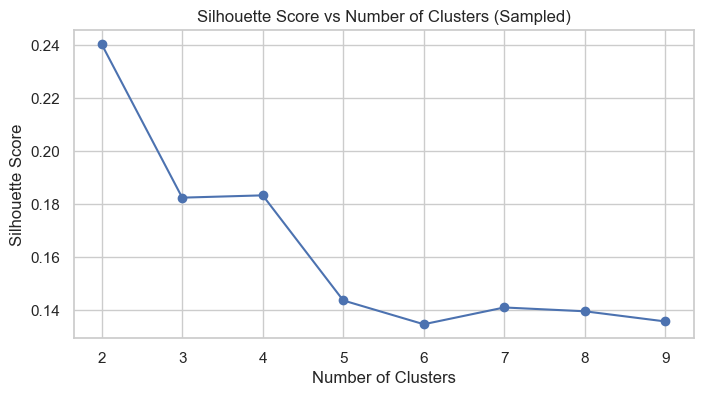

In [59]:
#  Sample for silhouette scoring 
sample_size = min(5000, X_scaled.shape[0]) 
sample_indices = np.random.choice(range(X_scaled.shape[0]), size=sample_size, replace=False)
X_sample_scaled = X_scaled[sample_indices]

# Silhouette cluster selection on sample
best_score = -1
best_k = 0
sil_scores = []

for k in range(2, 10):
    kmeans = KMeans(
        n_clusters=k,
        init='k-means++',
        n_init=10,        
        max_iter=300,     
        random_state=42
    )
    labels_sample = kmeans.fit_predict(X_sample_scaled)
    score = silhouette_score(X_sample_scaled, labels_sample)
    sil_scores.append(score)
    print(f"Clusters: {k}, Silhouette Score: {score:.3f}")
    
    if score > best_score:
        best_score = score
        best_k = k
        best_model = kmeans

print(f"Best number of clusters based on silhouette score: {best_k}")
print(f"Best Silhouette Score: {best_score:.3f}")

# Assign clusters to full dataset using best k
final_kmeans = KMeans(
    n_clusters=best_k,
    init='k-means++',
    n_init=10,
    max_iter=300,
    random_state=42
)
data1['cluster'] = final_kmeans.fit_predict(X_scaled)

# Examine cluster profiles
cluster_summary = data1.groupby('cluster')[cluster_features].mean()
print("Cluster Summary:")
print(cluster_summary)

#  Plot silhouette scores
plt.figure(figsize=(8,4))
plt.plot(range(2,10), sil_scores, marker='o')
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.title("Silhouette Score vs Number of Clusters (Sampled)")
plt.show()

In [60]:
def detailed_training_recommendation(row):
    recs = []

    # High usage vs low usage
    if row['minutes_played'] > 25:
        recs.append("Manage load and recovery")
    else:
        recs.append("Increase court time and endurance training")

    # Scoring & shooting
    if row['rolling_points_mean'] > 12:
        recs.append("Maintain scoring drills; optimize shot selection")
    elif row['rolling_points_mean'] < 6:
        recs.append("Focus on scoring development and finishing skills")

    # Assists / playmaking
    if row['rolling_assists_mean'] > 3:
        recs.append("Enhance decision-making and passing drills")
    elif row['rolling_assists_mean'] < 2:
        recs.append("Work on ball-handling and court vision")

    # Rebounds
    if row['rolling_rebounds_mean'] > 5:
        recs.append("Maintain rebounding positioning and strength")
    elif row['rolling_rebounds_mean'] < 3:
        recs.append("Focus on rebounding techniques and boxing out")

    # Shooting efficiency
    if row['rolling_field_goal_pct_mean'] < 0.4:
        recs.append("Improve shooting mechanics and shot selection")
    if row['rolling_3pt_pct_mean'] < 0.25:
        recs.append("Include 3-point shooting practice")

    # Fatigue
    if row['fatigue_index'] > 1.0:
        recs.append("Include recovery and low-intensity sessions")

    return "; ".join(recs)

# Apply to dataset
data1['training_recommendation'] = data1.apply(detailed_training_recommendation, axis=1)

# Example: check recommendations for first 5 players
data1.cluster.value_counts()


cluster
1    228075
0    212716
Name: count, dtype: int64

In [61]:
# Function to generate cluster-level recommendations
def cluster_training_summary(cluster_df):
    recs = []

    # Minutes played
    avg_minutes = cluster_df['minutes_played'].mean()
    if avg_minutes > 25:
        recs.append("High minutes: focus on recovery and load management")
    else:
        recs.append("Low minutes: increase court time and endurance training")

    # Scoring
    avg_points = cluster_df['rolling_points_mean'].mean()
    if avg_points > 12:
        recs.append("High scoring: maintain shooting drills and optimize shot selection")
    elif avg_points < 6:
        recs.append("Low scoring: focus on scoring development and finishing skills")

    # Assists
    avg_assists = cluster_df['rolling_assists_mean'].mean()
    if avg_assists > 3:
        recs.append("Good playmaking: enhance decision-making and passing drills")
    elif avg_assists < 2:
        recs.append("Low playmaking: work on ball-handling and court vision")

    # Rebounds
    avg_rebounds = cluster_df['rolling_rebounds_mean'].mean()
    if avg_rebounds > 5:
        recs.append("Strong rebounding: maintain positioning and strength")
    elif avg_rebounds < 3:
        recs.append("Low rebounding: focus on techniques and boxing out")

    # Shooting efficiency
    avg_fg = cluster_df['rolling_field_goal_pct_mean'].mean()
    avg_3pt = cluster_df['rolling_3pt_pct_mean'].mean()
    if avg_fg < 0.4:
        recs.append("Improve FG%: focus on shooting mechanics and shot selection")
    if avg_3pt < 0.25:
        recs.append("Improve 3PT%: include 3-point shooting practice")

    # Fatigue
    avg_fatigue = cluster_df['fatigue_index'].mean()
    if avg_fatigue > 1.0:
        recs.append("High fatigue: include recovery and low-intensity sessions")

    return "; ".join(recs)

# Apply cluster summary
cluster_recommendations = data1.groupby('cluster').apply(cluster_training_summary)
cluster_recommendations = pd.DataFrame(cluster_recommendations, columns=['Cluster_Training_Recommendation'])

print(cluster_recommendations)


                           Cluster_Training_Recommendation
cluster                                                   
0        High minutes: focus on recovery and load manag...
1        Low minutes: increase court time and endurance...


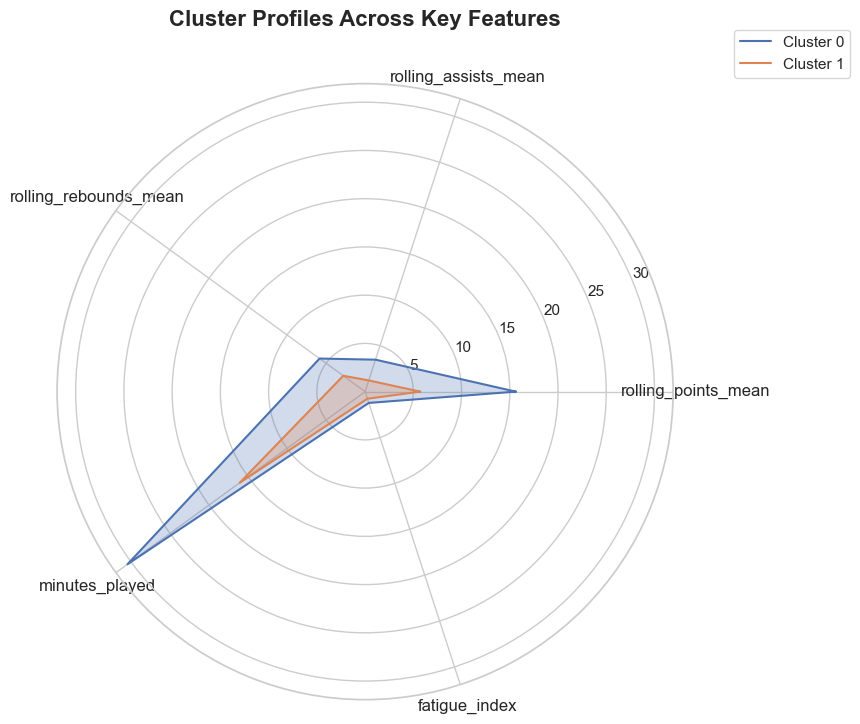

In [62]:
# Features to include in radar chart
features = [
    'rolling_points_mean', 'rolling_assists_mean', 'rolling_rebounds_mean',
    'minutes_played', 'fatigue_index'
]

# Calculate cluster means
cluster_means = data1.groupby('cluster')[features].mean()

# Number of variables
num_vars = len(features)

# Compute angle of each axis in the plot (in radians)
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

# Make the plot circular by repeating the first value at the end
angles += angles[:1]

# Plot
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

# Plot each cluster
for i, row in cluster_means.iterrows():
    values = row.tolist()
    values += values[:1]  # repeat first value
    ax.plot(angles, values, label=f'Cluster {i}')
    ax.fill(angles, values, alpha=0.25)

# Add feature labels
ax.set_xticks(angles[:-1])
ax.set_xticklabels(features, fontsize=12)

# Add title and legend
plt.title('Cluster Profiles Across Key Features', fontsize=16, fontweight='bold', y=1.08)
plt.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.show()

| Feature | Cluster 0 (Blue Line) | Cluster 1 (Orange Line) |
|---------|----------------------|------------------------|
| **Rolling Points Mean** | High (~30) → these players score a lot | Much lower (~5–6) → bench or lower-usage players |
| **Minutes Played** | High → they play longer in games | Low (~16) → less game time |
| **Assists** | Moderate to high | Lower |
| **Rebounds** | Moderate to high | Lower |
| **Fatigue Index** | Slightly higher → more likely to experience fatigue | Lower → likely less fatigued, less workload |

In [63]:
data1[['player_name','cluster', 'points','target_points','fatigue_event_next','injury_risk_next', 'training_recommendation']].sort_values(by = 'target_points', ascending = False)

,player_name,cluster,points,target_points,fatigue_event_next,injury_risk_next,training_recommendation
72939,Stephen Curry,0,26,62.0,0,0,Manage load and recovery; Maintain scoring dri...
68945,James Harden,0,61,61.0,0,0,Manage load and recovery; Maintain scoring dri...
68938,James Harden,0,61,61.0,0,0,Manage load and recovery; Maintain scoring dri...
69347,James Harden,0,61,61.0,0,0,Manage load and recovery; Maintain scoring dri...
69348,James Harden,0,61,61.0,0,0,Manage load and recovery; Maintain scoring dri...
...,...,...,...,...,...,...,...
440729,Facundo Campazzo,0,2,NaN,0,0,Increase court time and endurance training; En...
440734,Nate Darling,1,0,NaN,0,0,Increase court time and endurance training; Fo...
440764,Brodric Thomas,0,14,NaN,0,0,Manage load and recovery; Include recovery and...
440782,Freddie Gillespie,0,7,NaN,0,0,Manage load and recovery; Focus on scoring dev...


In [64]:
data1.fatigue_event_next.value_counts()

fatigue_event_next
0    290798
1    149993
Name: count, dtype: int64

### **Athlete Intelligence Index (AII)**

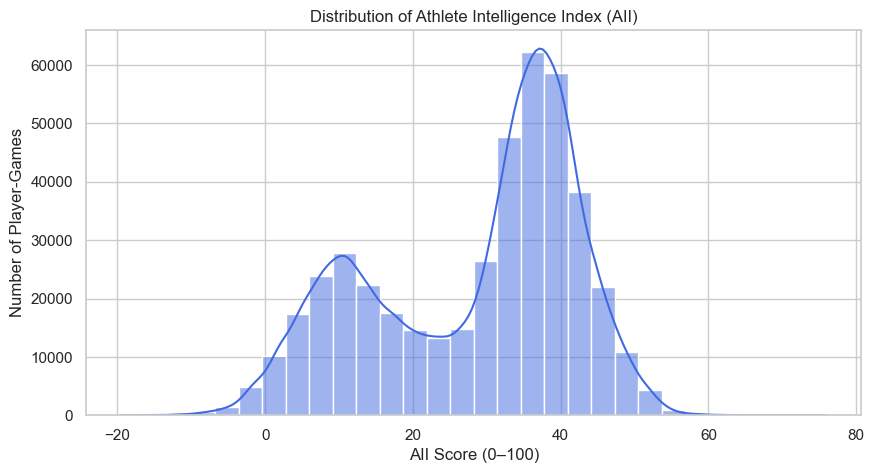

,player_name,game_date,next_points,fatigue_index,injury_risk_next,training_recommendation,AII_Score,AII_Status
23503,Giannis Antetokounmpo,2021-04-29,49.0,0.427778,0,Increase court time and endurance training; Ma...,75.92,Ready
34133,Jordan Nwora,2021-05-15,34.0,0.255556,0,Increase court time and endurance training; Fo...,70.55,Ready
38530,Kevin Durant,2021-04-18,33.0,0.411111,0,Increase court time and endurance training; Ma...,66.01,Ready
53449,Precious Achiuwa,2021-05-15,23.0,0.155556,0,Increase court time and endurance training; Fo...,65.95,Ready
58831,Skylar Mays,2021-02-10,20.0,0.100000,0,Increase court time and endurance training; Fo...,65.40,Ready
34611,Josh Jackson,2020-08-11,27.0,0.283333,0,Increase court time and endurance training; Fo...,65.34,Ready
64169,Trey Burke,2020-02-03,31.0,0.433333,0,Increase court time and endurance training; Fo...,64.17,Ready
46169,Max Strus,2021-05-15,20.0,0.155556,0,Increase court time and endurance training; Wo...,64.01,Ready
32644,Joel Embiid,2020-02-22,49.0,0.905556,0,Manage load and recovery; Maintain scoring dri...,63.97,Ready
59376,Stephen Curry,2021-01-01,62.0,1.244444,0,Manage load and recovery; Maintain scoring dri...,63.89,Ready


In [65]:
# Normalize key components
data1['perf_norm'] = data1['next_points'] / data1['next_points'].max()        
data1['fatigue_norm'] = 1 - data1['fatigue_index']                            
data1['injury_norm'] = 1 - data1['injury_risk_next']           

# Map training recommendation to numeric scale 
recommendation_map = {
    'rest': 0.2,
    'light': 0.6,
    'intense': 1.0
}
data1['train_norm'] = data1['training_recommendation'].map(recommendation_map).fillna(0.5)

# Compute Athlete Intelligence Index (AII)
w_perf = 0.40   
w_fatigue = 0.25
w_injury = 0.25
w_training = 0.10

data1['Athlete_Intelligence_Index'] = (
    (w_perf * data1['perf_norm']) +
    (w_fatigue * data1['fatigue_norm']) +
    (w_injury * data1['injury_norm']) +
    (w_training * data1['train_norm'])
)

# Scale to a 0–100 range 
data1['AII_Score'] = (data1['Athlete_Intelligence_Index'] * 100).round(2)

# Categorize into readiness levels
def readiness_label(score):
    if score >= 80:
        return "Peak Readiness"
    elif score >= 60:
        return "Ready"
    elif score >= 40:
        return "Moderate Fatigue"
    else:
        return "High Risk / Rest Needed"

data1['AII_Status'] = data1['AII_Score'].apply(readiness_label)


# Visualization 1: Distribution of AII
plt.figure(figsize=(10,5))
sns.histplot(data1['AII_Score'], bins=30, kde=True, color='royalblue')
plt.title("Distribution of Athlete Intelligence Index (AII)")
plt.xlabel("AII Score (0–100)")
plt.ylabel("Number of Player-Games")
plt.show()

# Group by player and date 
data_agg = (
    data1.groupby(['player_name', 'game_date'], as_index=False)
         .agg({
             'next_points': 'mean',
             'fatigue_index': 'mean',
             'injury_risk_next': 'max',  
             'training_recommendation': 'first',  
             'AII_Score': 'mean',
             'AII_Status': 'first'
         })
)

# Sort by AII_Score descending to see most at-risk players
data_agg = data_agg.sort_values('AII_Score', ascending = False)

display(data_agg.head(10))


In [66]:
data1['AII_Status'].value_counts()

AII_Status
High Risk / Rest Needed    347759
Moderate Fatigue            92962
Ready                          70
Name: count, dtype: int64

In [67]:
# Save results for deployment
data1[['player_name','game_date','next_points','fatigue_index','injury_risk_next',
       'training_recommendation','AII_Score','AII_Status']].to_csv('athlete_intelligence_index.csv', index=False)
print("AII results saved to athlete_intelligence_index.csv")

AII results saved to athlete_intelligence_index.csv


##  **CRISP-DM Phase 6: Conclusion**

The Athlete360 project successfully demonstrated how data-driven methods can be used to monitor, predict, and enhance athletic performance through the integration of physical, workload, and fatigue indicators.

Key conclusions derived from the analysis and modeling process include:

* Performance is highly influenced by workload and efficiency metrics.
Exploratory data analysis revealed that shot attempts, minutes played, and field goals made are the strongest predictors of next-game performance, indicating that player workload and opportunity remain central to offensive output.

* Fatigue and injury risk are inversely related to readiness.
Players with elevated fatigue indices or higher injury risk consistently exhibited lower predicted readiness and performance scores. This highlights the importance of recovery cycles and workload management in sustaining high-level performance.

* Machine learning models achieved meaningful predictive accuracy.
The LightGBM model particularly provided reliable forecasts for player performance and injury likelihood. This validates the feasibility of applying AI for sports performance prediction and player management.

* Clustering identified distinct athlete profiles.
Using K-Means clustering, players were grouped into categories such as High-Performance/High-Risk, Balanced/Moderate Fatigue, and Underperforming/Low Fatigue. These profiles can assist coaches in tailoring training and rest programs for different athlete archetypes.

* Data integration is critical for holistic insights.
Combining performance statistics with rolling averages, fatigue metrics, and injury indicators provided a multidimensional understanding of athlete readiness—something traditional box-score analytics cannot capture alone.


##  **CRISP-DM Phase 7: Recommendations**

* Adopt Predictive Analytics in Player Management - Integrate the Athlete360 model into regular performance reviews to support objective, data-driven decisions on player readiness, workload, and rotation strategies.

* Implement Individualized Recovery Protocols - Tailor recovery interventions (sleep, nutrition, physiotherapy) based on predicted fatigue scores and player cluster profiles. High-fatigue players should receive extended rest or light sessions to accelerate recovery.


* Use Model Insights to Prevent Injuries - Leverage the fatigue and injury-risk predictions to proactively rest or modify training for high-risk players, reducing injury-related costs and downtime.

* Encourage Cross-Department Collaboration - Facilitate collaboration between data analysts, coaching staff, and medical teams to translate predictive insights into practical actions during training and match preparation.


* Prioritize Explainable AI for Trust and Adoption - Ensure transparency of model decisions using explainability tools so that coaching staff understand and trust the basis for recommendations.


* Pilot and Scale Gradually - Start with a pilot implementation on a selected team or training phase, assess impact, then scale the system across departments and seasons for maximum value.

## DEPLOYMENT

In [68]:
import joblib

joblib.dump(best_model, 'lgbm_performance_model.joblib') 

joblib.dump(rf, 'rf_injury_model.joblib')

joblib.dump(final_kmeans, 'kmeans_cluster_model.joblib')

joblib.dump(scaler, 'cluster_scaler.joblib')

['cluster_scaler.joblib']